In [1]:
import importlib
import time
import numpy as np
import scipy as sp
import matplotlib.pyplot as plt
from scipy import ndimage
from scipy import integrate
from scipy import interpolate

In [2]:
from multi_loc import covariance, assimilate, utilities

/home/travisharty/anaconda3/envs/loc/lib/python3.7/site-packages/sklearn/utils/__init__.py:4: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated, and in 3.8 it will stop working
  from collections import Sequence


In [3]:
%matplotlib inline

In [4]:
def imshow(X, title=None, vmin=None, vmax=None, cmap=None):
    plt.figure()
    im = plt.imshow(X, vmin=vmin, vmax=vmax, cmap=cmap)
    plt.colorbar(im)
    plt.title(title)

In [5]:
N_Z = 960
K = 32
I = 12
F = float(15)
b = float(10)
c = float(2.5)
alpha = (3 * I**2 + 3) / (2 * I**3 + 4 * I)
beta = (2 * I**2 + 1) / (I**4 + 2 * I**2)

coarse = 8
N_Xcoar = N_Z//coarse
K_coar = K//coarse

N_eZ = 20
N_eX = 500

# Long run to generate ensemble

In [6]:
# X_interp = np.random.uniform(low=-5, high=10, size=N_Z//K)
# X_interp = np.concatenate([X_interp, [X_interp[0]]])
# x = np.arange(N_Z)
# x_interp = x[::K]
# x_interp = np.concatenate([x_interp, [x[-1] + 1]])
# f_X = interpolate.interp1d(x_interp, X_interp, kind='quadratic')
# X0 = f_X(x)
# Y0 = np.random.uniform(low=-0.5, high=1, size=N_Z)
# Z0 = X0 + X0*Y0/X0.max()
# t = np.linspace(0, 20, 100)
# Z = utilities.return_LM3_data(Z0, t, K=K, I=I, F=F, b=b, c=c)
# Z0 = Z[:, -1]
# T = 1000
# dt = 0.05
# N = int(T/dt + 1)
# t = np.linspace(0, T, N)
# Z = utilities.return_LM3_data(Z0, t, K=K, I=I, F=F, b=b, c=c)
# np.save('./Z_long_run.npy', Z)

Z = np.load('./Z_long_run.npy')

# Generate ensemble from long run

In [7]:
# X0_ens, Z0_ens = utilities.generate_X_Y_LM3_ens(Z, N_eX, N_eZ, coarse, I, alpha, beta)


# np.save('X0_ens', X0_ens)
# np.save('Z0_ens', Z0_ens)
X0_ens = np.load('X0_ens.npy')
Z0_ens = np.load('Z0_ens.npy')

In [8]:
P_X = np.cov(X0_ens)
P_Z = np.cov(Z0_ens)

In [9]:
H_subgrid = np.eye(P_X.shape[0])
R_subgrid = 1 * np.eye(P_X.shape[0])
trans_mats = assimilate.transformation_matrices(
    H_subgrid, P=P_X,
    R=R_subgrid, return_Ts=True)

for key, val in trans_mats.items():
    key = key + '_X'
    print(key)
    exec(key + '=val')

P_sqrt_X
P_inv_sqrt_X
R_sqrt_X
R_inv_sqrt_X
U_X
S_X
VT_X
H_X
Tx_X
Tx_inv_X
Ty_X
Ty_inv_X


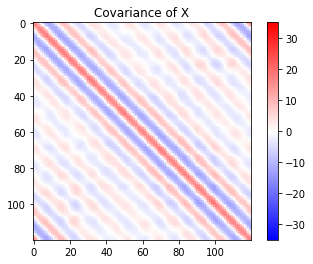

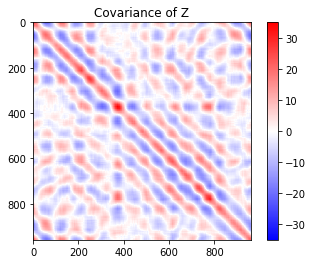

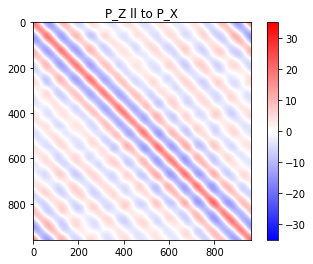

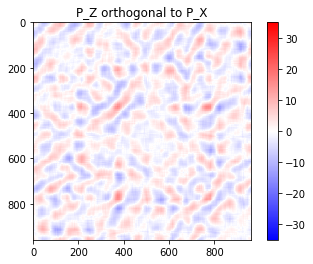

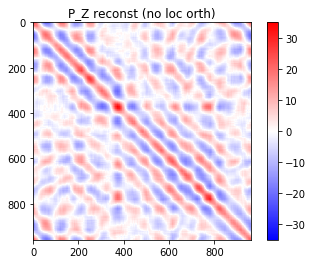

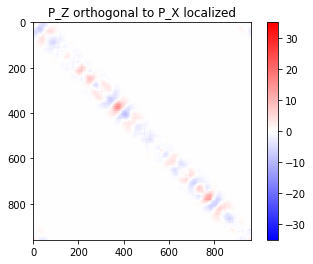

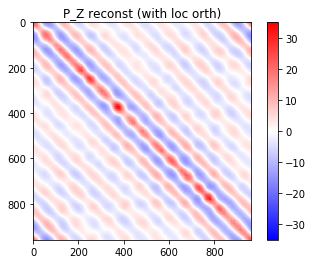

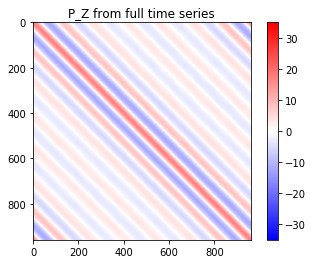

In [62]:
VT_X_interp = utilities.upscale_on_loop(VT_X, coarse)

proj0 = VT_X_interp.T @ VT_X_interp

P_Z_ll_X = (VT_X_interp.T
        @ np.diag(np.diag(VT_X_interp @ P_Z @ VT_X_interp.T))
        @ VT_X_interp)
# P_Z_ll_X = proj0 @ P_Z @ proj0

proj = np.eye(N_Z) - proj0

D_inv_sqrt = np.diag(1/np.sqrt(np.diag(P_Z_ll_X)))

rho_Z_ll_X = D_inv_sqrt @ P_Z_ll_X @ D_inv_sqrt

P_Z_orth_X = P_Z - P_Z_ll_X

# P_Z_orth_X_loc = rho_Z_ll_X * P_Z_orth_X
P_Z_orth_X_loc = rho * P_Z_orth_X

P_Z_reconst = P_Z_ll_X + P_Z_orth_X

P_Z_reconst_loc = P_Z_ll_X + P_Z_orth_X_loc

P_Z_GT = np.cov(Z)

vmax = np.max(
    [np.abs(P_Z).max(),
     np.abs(P_Z_ll_X).max(),
     np.abs(P_Z_orth_X).max(),
     np.abs(P_Z_reconst).max(),
     np.abs(P_Z_reconst_loc).max(), 
     np.abs(P_Z_GT).max()])
vmax_X = np.abs(P_X).max()

imshow(P_X, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='Covariance of X')
imshow(P_Z, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='Covariance of Z')
imshow(P_Z_ll_X, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z ll to P_X')
# imshow(diff, vmax=vmax, vmin=-vmax, cmap='bwr',
#        title='P_X - P_Z_ll')
imshow(P_Z_orth_X, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z orthogonal to P_X')
imshow(P_Z_reconst, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z reconst (no loc orth)')
imshow(P_Z_orth_X_loc, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z orthogonal to P_X localized')
imshow(P_Z_reconst_loc, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z reconst (with loc orth)')
imshow(P_Z_GT, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='P_Z from full time series')

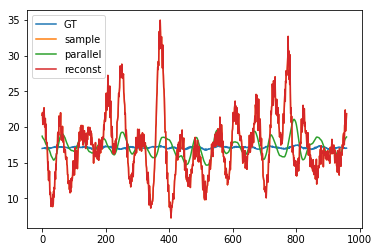

In [78]:
plt.figure()
plt.plot(np.diag(P_Z_GT))
plt.plot(np.diag(P_Z))
plt.plot(np.diag(P_Z_ll_X))
plt.plot(np.diag(P_Z_reconst_loc))
plt.legend(['GT', 'sample', 'parallel', 'reconst'])

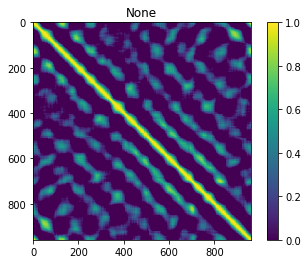

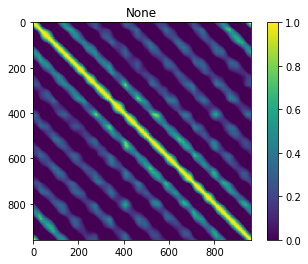

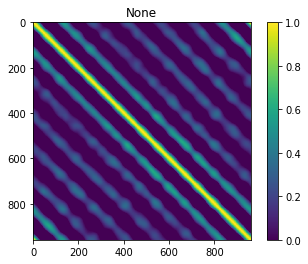

In [74]:
D_sqrt_inv = np.diag(1/np.sqrt(np.diag(P_Z)))
C_Z = D_sqrt_inv @ P_Z @ D_sqrt_inv
imshow(C_Z, vmin=0, vmax=1)

D_sqrt_inv = np.diag(1/np.sqrt(np.diag(P_Z_reconst_loc)))
C_Z_loc = D_sqrt_inv @ P_Z_reconst_loc @ D_sqrt_inv
imshow(C_Z_loc, vmin=0, vmax=1)

D_sqrt_inv = np.diag(1/np.sqrt(np.diag(P_Z_ll_X)))
C_Z_ll = D_sqrt_inv @ P_Z_ll_X @ D_sqrt_inv
imshow(C_Z_ll, vmin=0, vmax=1)

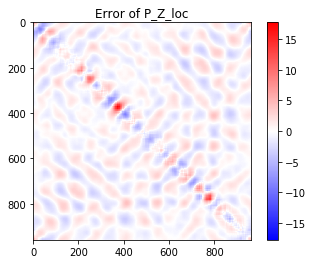

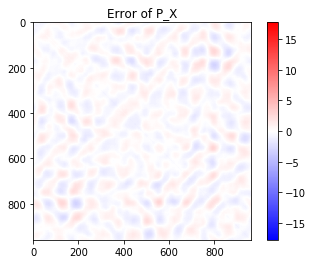

In [64]:
P_X_interp = VT_X_interp.T @ S_X**2 @ VT_X_interp * coarse

error_P_Z_loc = P_Z_reconst_loc - P_Z_GT
error_P_X = P_X_interp - P_Z_GT
vmax = np.max(
    [np.abs(error_P_Z_loc),
     np.abs(error_P_X)])
imshow(error_P_Z_loc, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='Error of P_Z_loc')
imshow(error_P_X, vmax=vmax, vmin=-vmax, cmap='bwr',
       title='Error of P_X')

In [12]:
# X_interp = np.random.uniform(low=-5, high=10, size=N_Z//K)
# X_interp = np.concatenate([X_interp, [X_interp[0]]])
# x = np.arange(N_Z)
# x_interp = x[::K]
# x_interp = np.concatenate([x_interp, [x[-1] + 1]])
# f_X = interpolate.interp1d(x_interp, X_interp, kind='quadratic')
# X0 = f_X(x)
# Y0 = np.random.uniform(low=-0.5, high=1, size=N_Z)
# Z0 = X0 + X0*Y0/X0.max()
# t = np.linspace(0, 20, 100)
# Z_temp = utilities.return_LM3_data(Z0, t, K=K, I=I, F=F, b=b, c=c)
# Z0 = Z_temp[:, -1]
# T = 1000
# dt = 0.05
# N = int(T/dt + 1)
# t = np.linspace(0, T, N)
# Z_GT = utilities.return_LM3_data(Z0, t, K=K, I=I, F=F, b=b, c=c)
# np.save('./Z_GT.npy', Z_GT)

Z_GT = np.load('./Z_GT.npy')

# Assimilate first obs

In [21]:
R_sig = 2
every_Z_obs = 4
H_sub = np.eye(N_Z//coarse)
R_sub = 1 * np.eye(N_Z//coarse)
H = np.eye(N_Z)[::every_Z_obs]
R = R_sig**2 * np.eye(N_Z//every_Z_obs)
R_coar = R_sig**2 * np.eye(N_Z//coarse)
Z_obs = np.random.multivariate_normal(H @ Z_GT[:, 0], R)
x_full = np.arange(N_Z)
x_obs = H @ x_full
x_coar = x_full[::coarse]

In [22]:
Z_interp = utilities.interp_on_loop(Z=Z_obs, x=x_obs, x_interp=x_full)
X_interp = utilities.window_sum_Z(Z_interp, I=I, alpha=alpha, beta=beta)
X_obs = X_interp[::coarse]

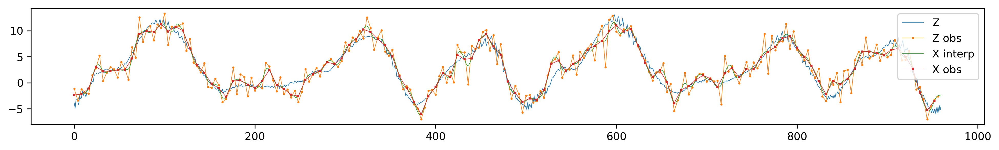

In [23]:
figsize = plt.figaspect(1/8)
plt.figure(dpi=300, figsize=figsize)
plt.plot(Z_GT[:, 0], linewidth=0.5)
plt.plot(x_obs, Z_obs, '-o', markersize=1, linewidth=0.5)
plt.plot(X_interp, linewidth=0.5)
plt.plot(x_coar, X_obs, '-s', markersize=1, linewidth=0.5)
plt.legend(['Z', 'Z obs', 'X interp', 'X obs'])

# Use SVD localization

In [67]:
importlib.reload(assimilate)

<module 'multi_loc.assimilate' from '/home/travisharty/Documents/python_code/multi_loc/multi_loc/assimilate.py'>

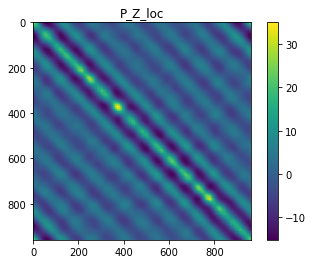

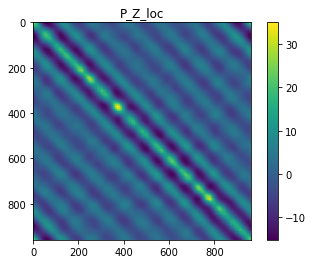

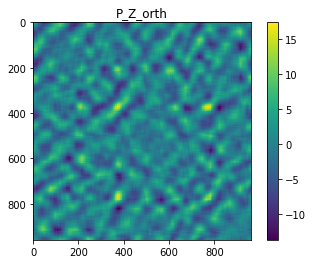

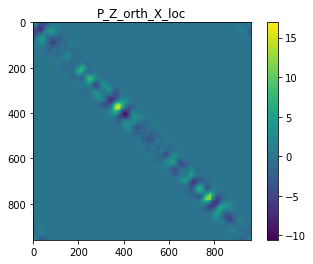

In [68]:
[rho_coar] = covariance.generate_circulant(N_Z, 1, 40, covariance.fft_sqd_exp_1d,
                                             return_Corr=True, return_eig=False)

X_ens_a, Z_ens_a = assimilate.dual_scale_enkf(
    X0_ens, Z0_ens, X_obs, Z_obs, H=H, R=R, R_coar=R_coar,
    H_sub=H_sub, R_sub=R_sub, coarse=coarse, rho_coar=rho_coar)

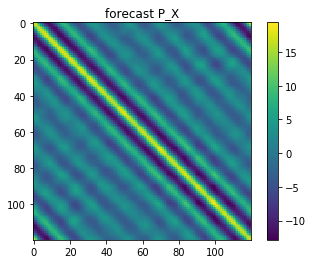

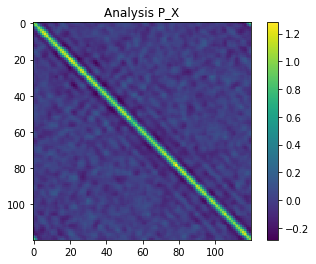

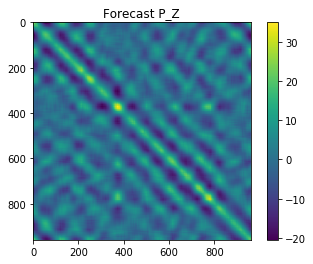

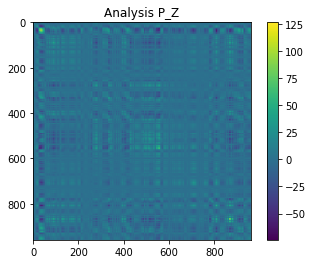

In [69]:
P_X_f = np.cov(X0_ens)
P_X_a = np.cov(X_ens_a)
P_Z_f = np.cov(Z0_ens)
P_Z_a = np.cov(Z_ens_a)

imshow(P_X_f, 'forecast P_X')
imshow(P_X_a, 'Analysis P_X')
imshow(P_Z_f, 'Forecast P_Z')
imshow(P_Z_a, 'Analysis P_Z')

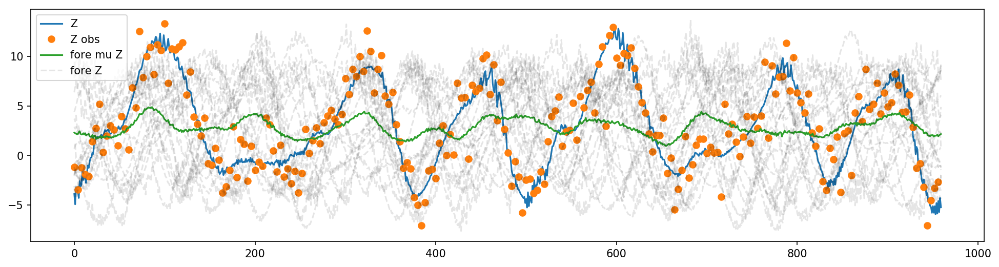

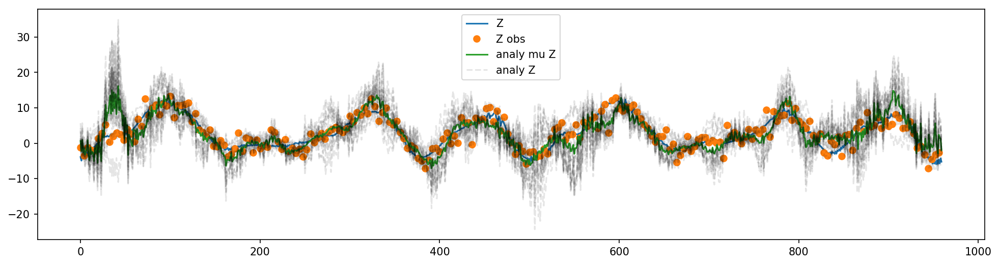

In [70]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_obs, Z_obs, 'o')
plt.plot(np.mean(Z0_ens, axis=-1))
plt.plot(Z0_ens, 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'fore mu Z', 'fore Z'])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_obs, Z_obs, 'o')
plt.plot(np.mean(Z_ens_a, axis=-1))
plt.plot(Z_ens_a, 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'analy mu Z', 'analy Z'])

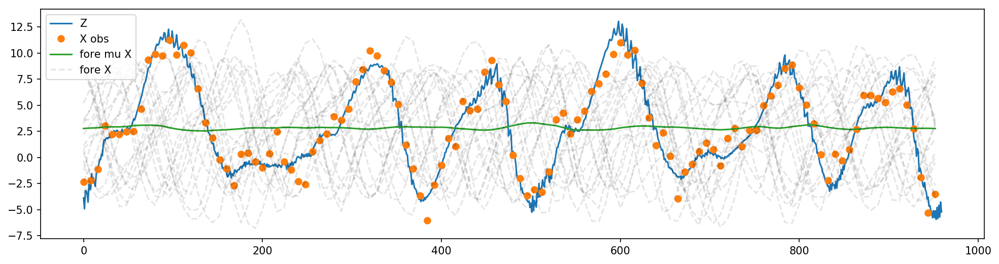

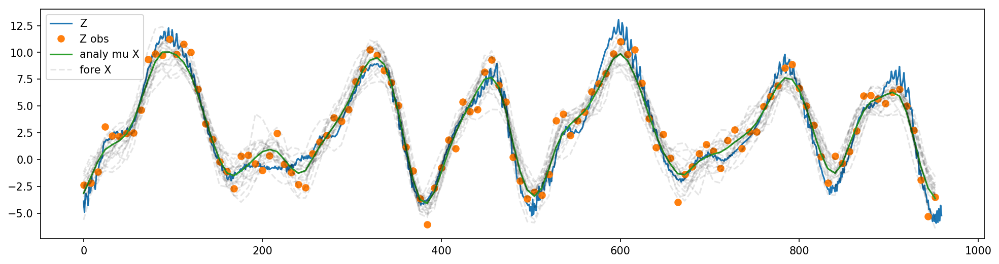

In [43]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coar, X_obs, 'o')
plt.plot(x_coar, np.mean(X0_ens, axis=-1))
plt.plot(x_coar, X0_ens[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'X obs', 'fore mu X', 'fore X'])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coar, X_obs, 'o')
plt.plot(x_coar, np.mean(X_ens_a, axis=-1))
plt.plot(x_coar, X_ens_a[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'analy mu X', 'fore X'])

# No localization

In [227]:
use_SVD_loc = False
X_ens_a, Z_ens_a = assimilate.dual_scale_enkf(
    X0_ens, Z0_ens, X_obs, Z_obs, H=H, R=R, R_coar=R_coar,
    H_sub=H_sub, R_sub=R_sub, coarse=coarse,
    use_SVD_loc=use_SVD_loc)

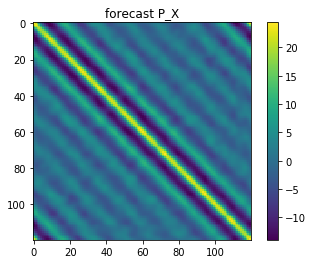

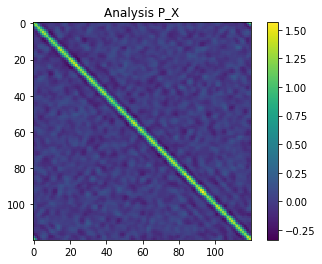

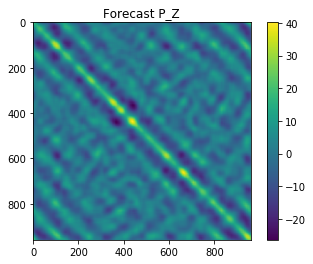

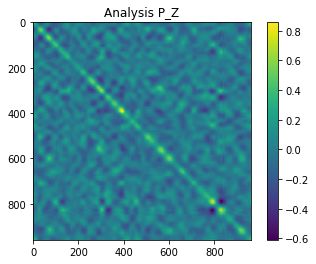

In [228]:
P_X_f = np.cov(X0_ens)
P_X_a = np.cov(X_ens_a)
P_Z_f = np.cov(Z0_ens)
P_Z_a = np.cov(Z_ens_a)

imshow(P_X_f, 'forecast P_X')
imshow(P_X_a, 'Analysis P_X')
imshow(P_Z_f, 'Forecast P_Z')
imshow(P_Z_a, 'Analysis P_Z')

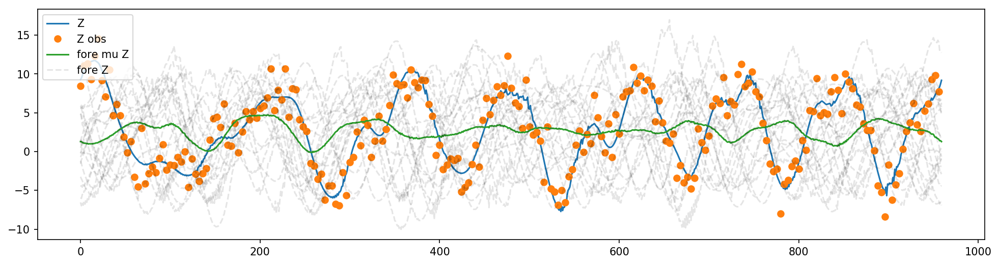

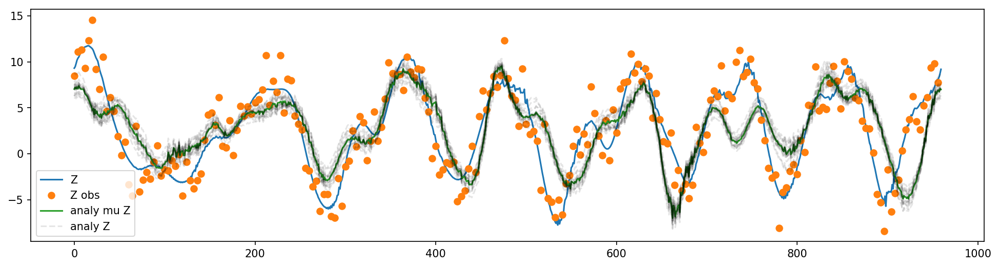

In [231]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_obs, Z_obs, 'o')
plt.plot(np.mean(Z0_ens, axis=-1))
plt.plot(Z0_ens, 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'fore mu Z', 'fore Z'])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_obs, Z_obs, 'o')
plt.plot(np.mean(Z_ens_a, axis=-1))
plt.plot(Z_ens_a, 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'analy mu Z', 'analy Z'])

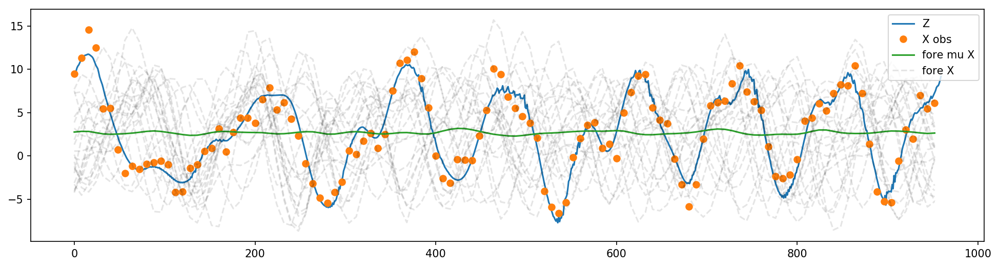

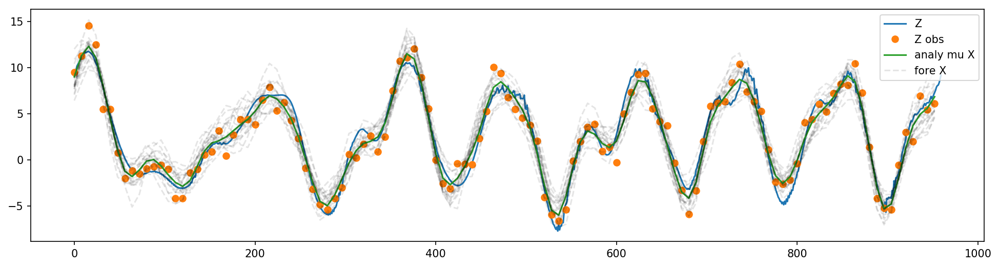

In [232]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coar, X_obs, 'o')
plt.plot(x_coar, np.mean(X0_ens, axis=-1))
plt.plot(x_coar, X0_ens[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'X obs', 'fore mu X', 'fore X'])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coar, X_obs, 'o')
plt.plot(x_coar, np.mean(X_ens_a, axis=-1))
plt.plot(x_coar, X_ens_a[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'analy mu X', 'fore X'])

# Use P_X as P_Z

In [256]:
importlib.reload(assimilate)

<module 'multi_loc.assimilate' from '/home/travisharty/Documents/python_code/multi_loc/multi_loc/assimilate.py'>

In [257]:
use_SVD_loc = False
use_P_X = True
X_ens_a, Z_ens_a = assimilate.dual_scale_enkf(
    X0_ens, Z0_ens, X_obs, Z_obs, H=H, R=R, R_coar=R_coar,
    H_sub=H_sub, R_sub=R_sub, coarse=coarse,
    use_SVD_loc=use_SVD_loc,
    use_P_X=use_P_X)

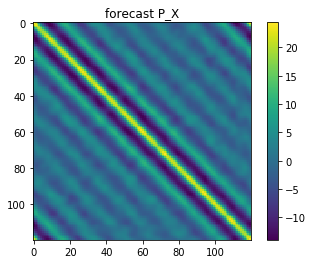

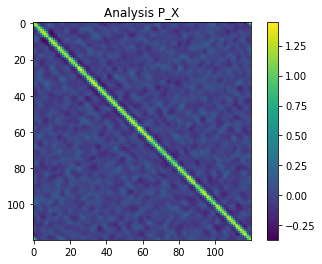

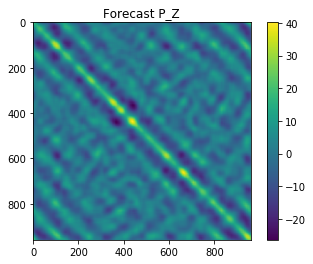

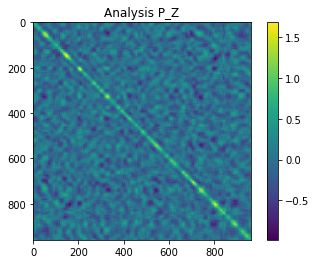

In [258]:
P_X_f = np.cov(X0_ens)
P_X_a = np.cov(X_ens_a)
P_Z_f = np.cov(Z0_ens)
P_Z_a = np.cov(Z_ens_a)

imshow(P_X_f, 'forecast P_X')
imshow(P_X_a, 'Analysis P_X')
imshow(P_Z_f, 'Forecast P_Z')
imshow(P_Z_a, 'Analysis P_Z')

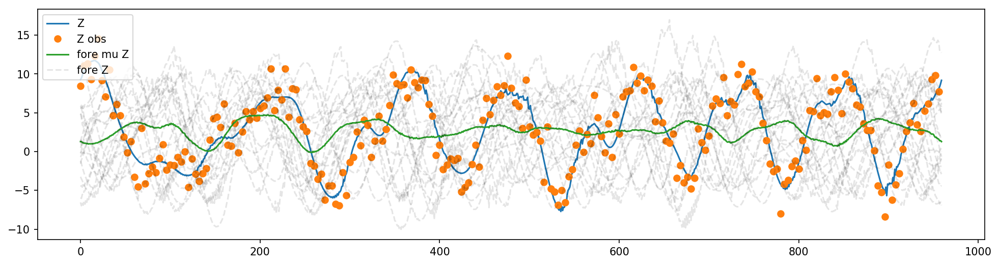

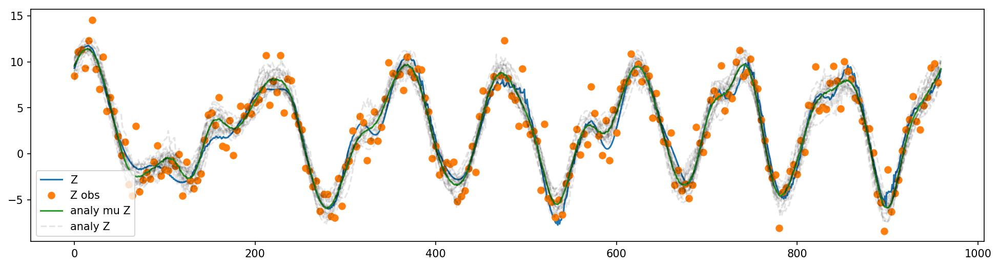

In [259]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_obs, Z_obs, 'o')
plt.plot(np.mean(Z0_ens, axis=-1))
plt.plot(Z0_ens, 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'fore mu Z', 'fore Z'])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_obs, Z_obs, 'o')
plt.plot(np.mean(Z_ens_a, axis=-1))
plt.plot(Z_ens_a, 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'analy mu Z', 'analy Z'])

ValueError: x and y must have same first dimension, but have shapes (120,) and (240,)

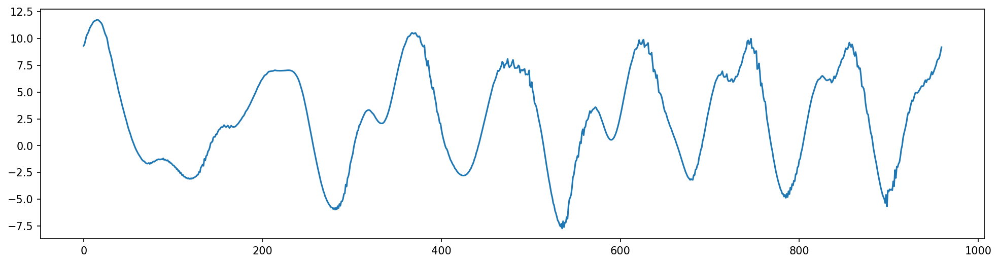

In [260]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_obs, X_obs, 'o')
plt.plot(x_coar, np.mean(X0_ens, axis=-1))
plt.plot(x_coar, X0_ens[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'fore mu X', 'fore X'])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coarse, Z_obs, 'o')
plt.plot(x_coarse, np.mean(X_ens_a, axis=-1))
plt.plot(x_coarse, X_ens_a[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'analy mu X', 'fore X'])

# With localization

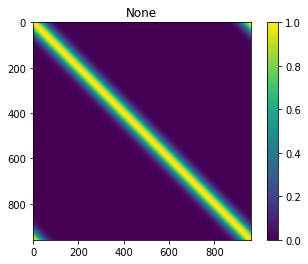

In [103]:
use_SVD_loc = False
[loc] = covariance.generate_circulant(N_Z, 1, 35, covariance.fft_sqd_exp_1d, return_Corr=True, return_eig=False)
imshow(loc)

X_ens_a, Z_ens_a = assimilate.dual_scale_enkf(
    X0_ens, Z0_ens, Z_obs, H=H, R=R, 
    H_sub=H_sub, R_sub=R_sub, rho=loc, coarse=coarse,
    use_SVD_loc=use_SVD_loc)

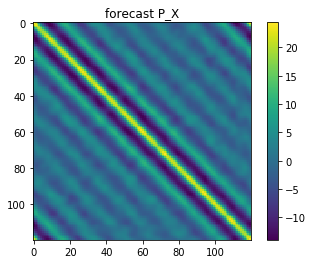

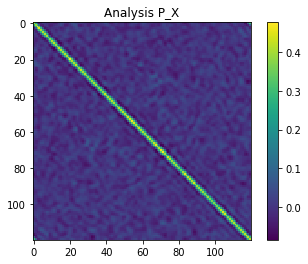

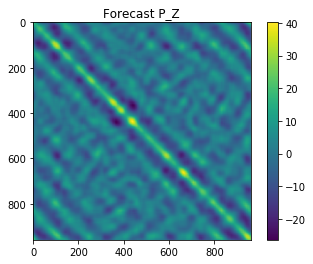

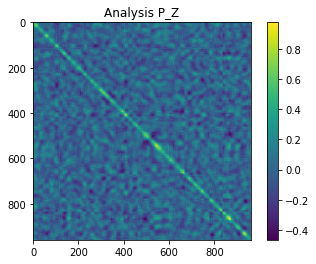

In [104]:
P_X_f = np.cov(X0_ens)
P_X_a = np.cov(X_ens_a)
P_Z_f = np.cov(Z0_ens)
P_Z_a = np.cov(Z_ens_a)

imshow(P_X_f, 'forecast P_X')
imshow(P_X_a, 'Analysis P_X')
imshow(P_Z_f, 'Forecast P_Z')
imshow(P_Z_a, 'Analysis P_Z')

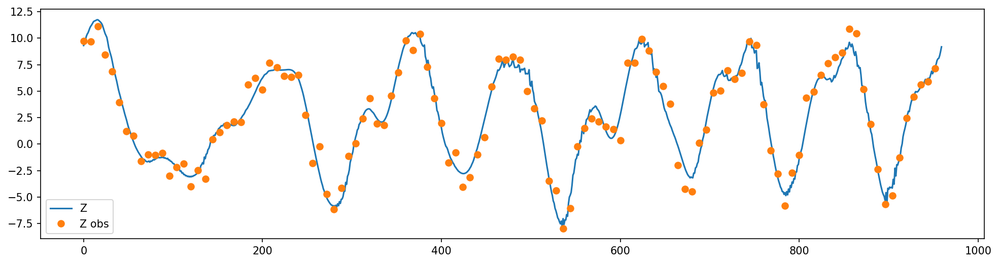

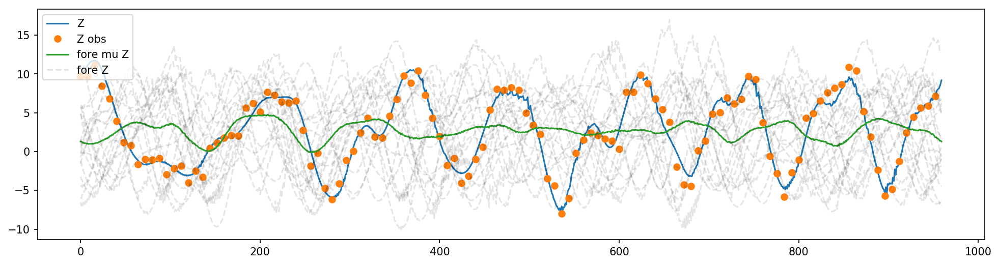

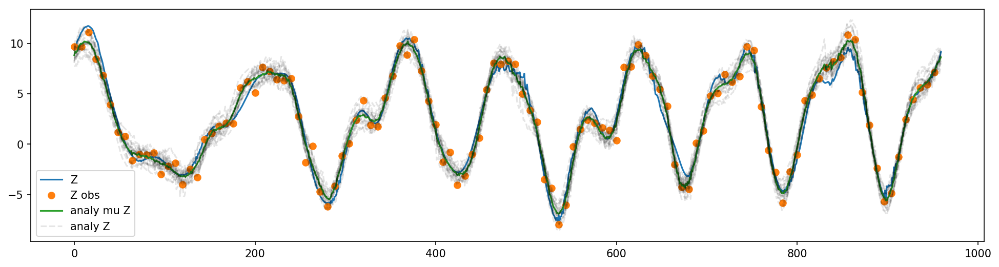

In [105]:
x = np.arange(N_Z)
x_coarse = x[::coarse]
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coarse, Z_obs, 'o')
plt.legend(['Z', 'Z obs'])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coarse, Z_obs, 'o')
plt.plot(np.mean(Z0_ens, axis=-1))
plt.plot(Z0_ens, 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'fore mu Z', 'fore Z'])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coarse, Z_obs, 'o')
plt.plot(np.mean(Z_ens_a, axis=-1))
plt.plot(Z_ens_a, 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'analy mu Z', 'analy Z'])

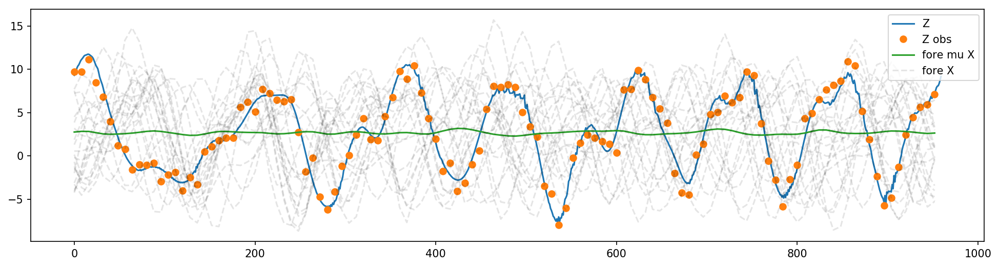

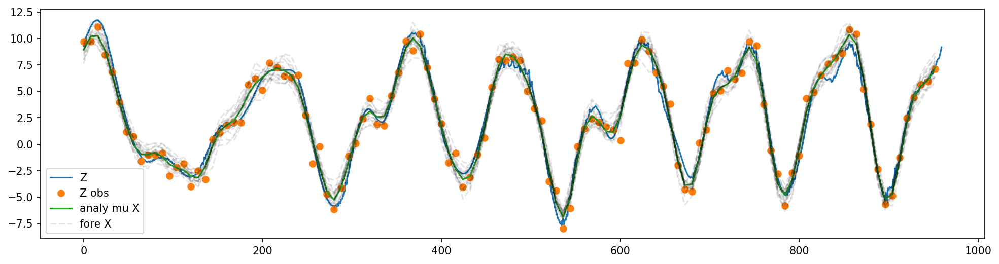

In [106]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coarse, Z_obs, 'o')
plt.plot(x_coarse, np.mean(X0_ens, axis=-1))
plt.plot(x_coarse, X0_ens[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'fore mu X', 'fore X'])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_GT[:, 0])
plt.plot(x_coarse, Z_obs, 'o')
plt.plot(x_coarse, np.mean(X_ens_a, axis=-1))
plt.plot(x_coarse, X_ens_a[:, ::25], 'k--', alpha=.1)
plt.legend(['Z', 'Z obs', 'analy mu X', 'fore X'])

In [69]:
X_coar_ens_ts = return_LM3_coar_ens_data(
    X0_ens, t[0: 20], Z_ens_ts, coarse=coarse, K=K, I=I, F=F, b=b, c=c, alpha=alpha, beta=beta)

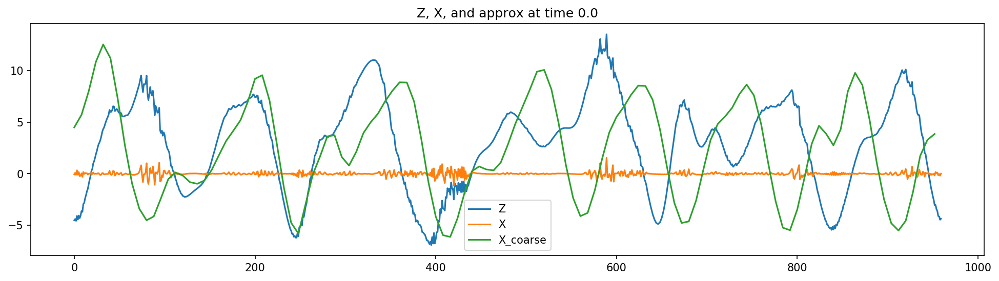

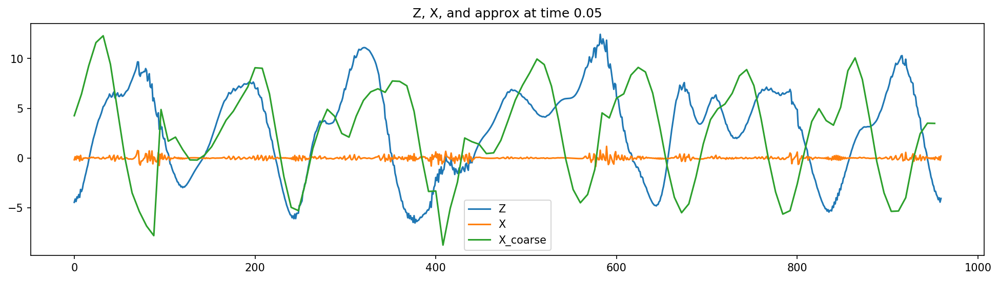

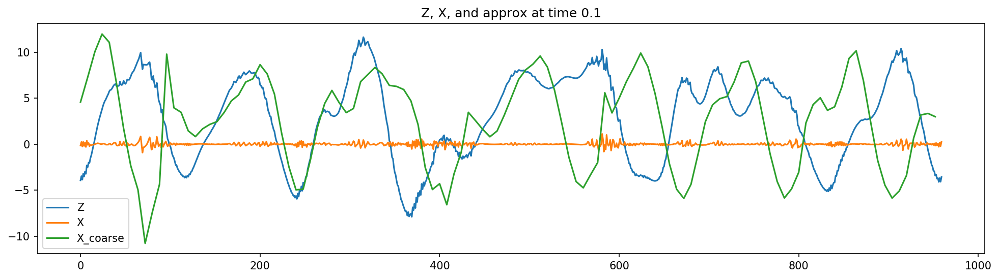

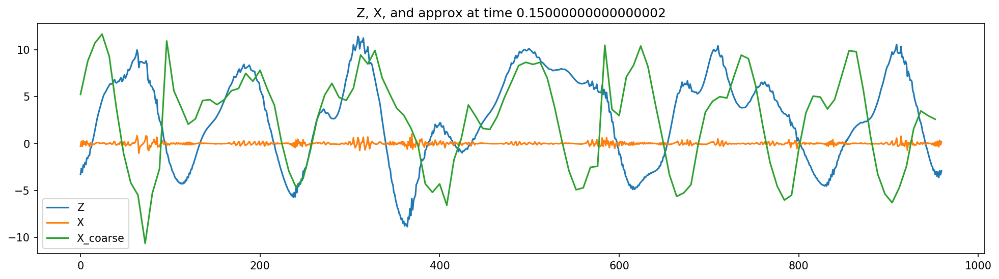

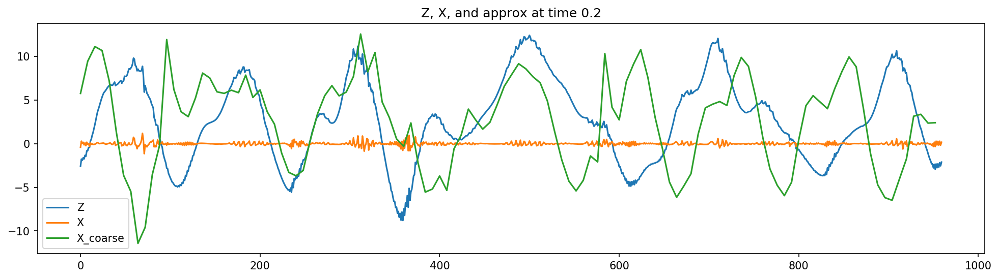

...

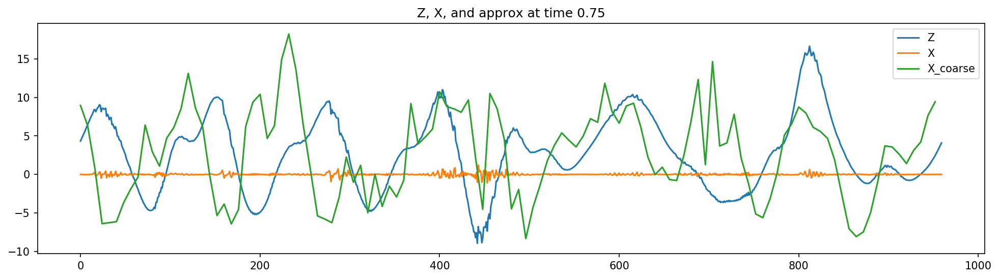

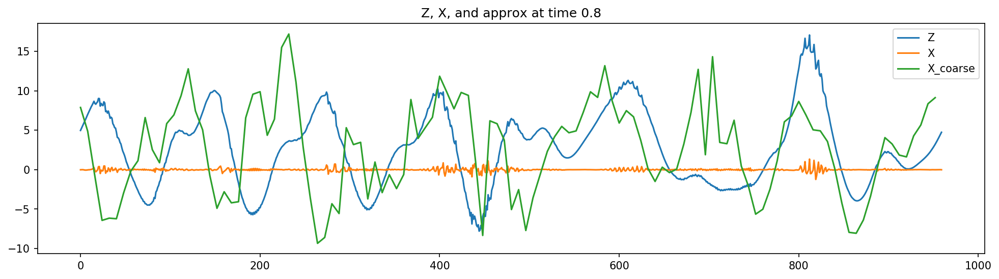

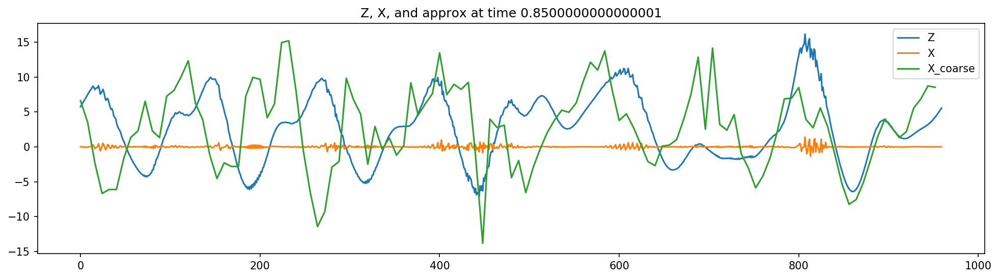

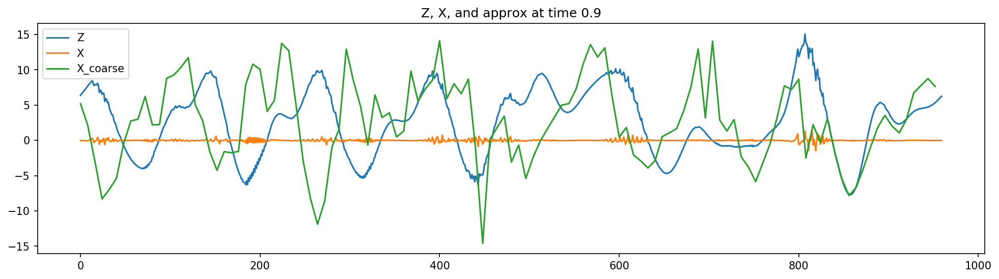

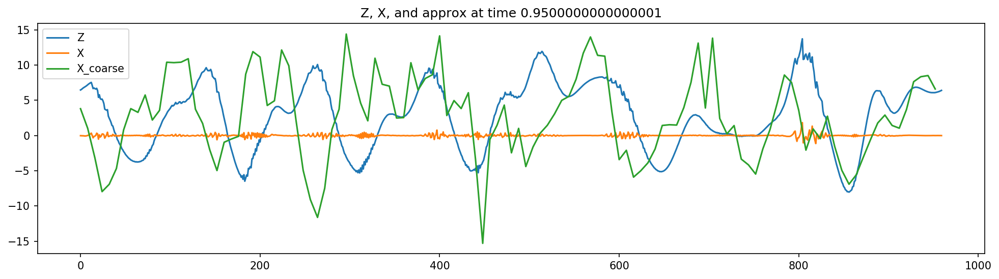

In [71]:
num_steps = 20
ens_num = 0
z_ens_num = int(np.floor(ens_num/(N_eX/N_eZ)))
for ii in range(num_steps): #range(XY.shape[0]):
#     ii = 5 * ii
    X_to_plot = X_coar_ens_ts[:, ens_num, ii]
    Z_to_plot = Z_ens_ts[:, z_ens_num, ii]
    Y_to_plot = window_sum_Z(Z_to_plot, I=I, alpha=alpha, beta=beta)
    Y_to_plot = Z_to_plot - Y_to_plot
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_to_plot)
    plt.plot(Y_to_plot)
    plt.plot(np.arange(0, N_Z, coarse), X_to_plot)
    plt.title(f'Z, X, and approx at time {t[ii]}')
    plt.legend(['Z', 'X', 'X_coarse', 'X_LM3_coar'])

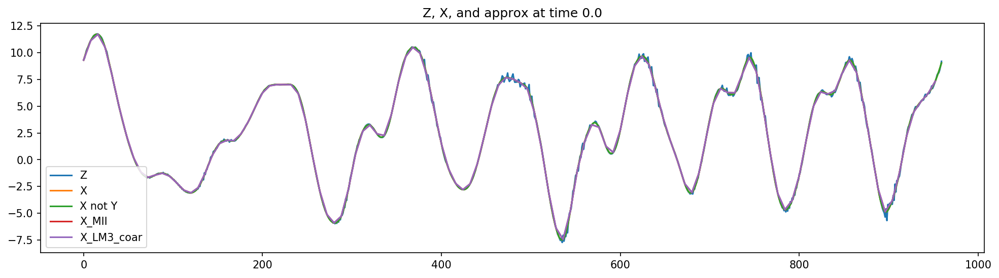

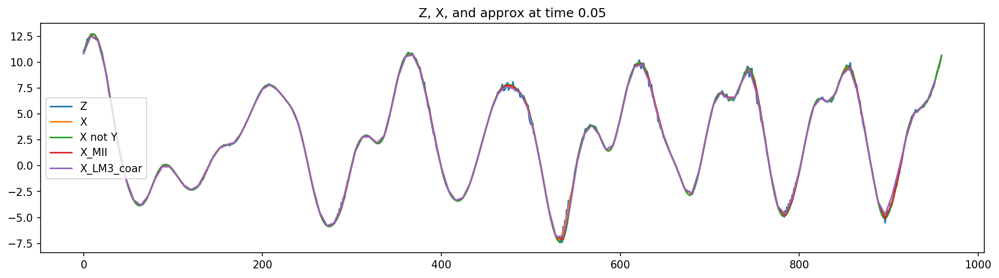

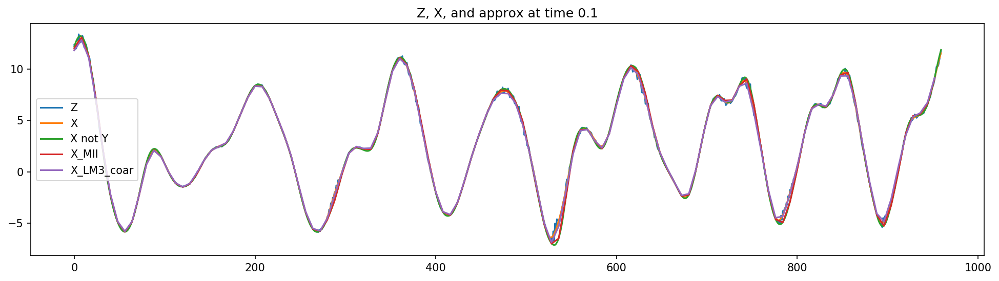

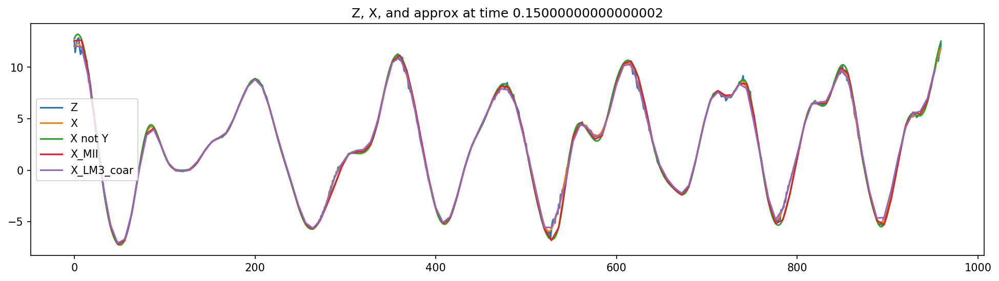

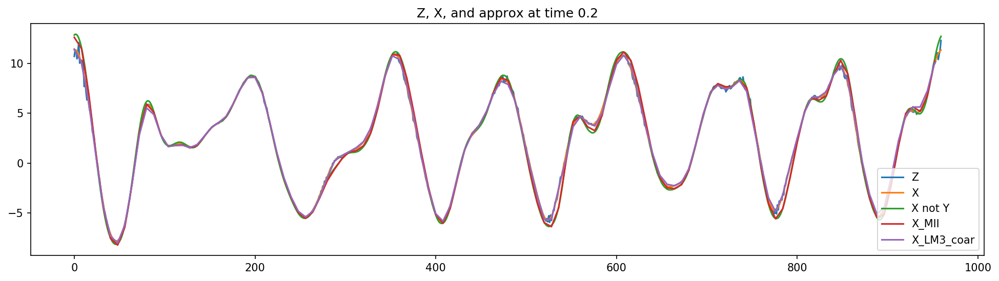

...

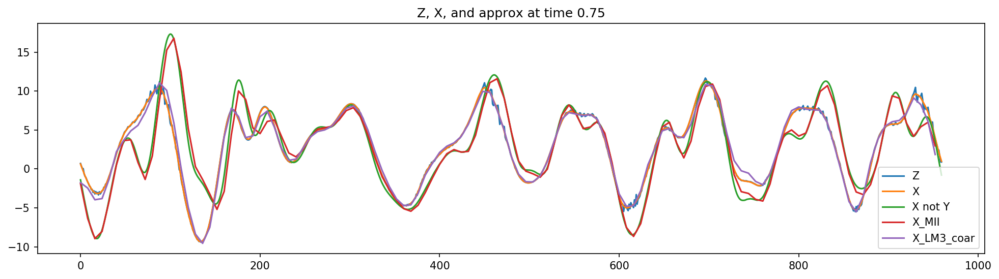

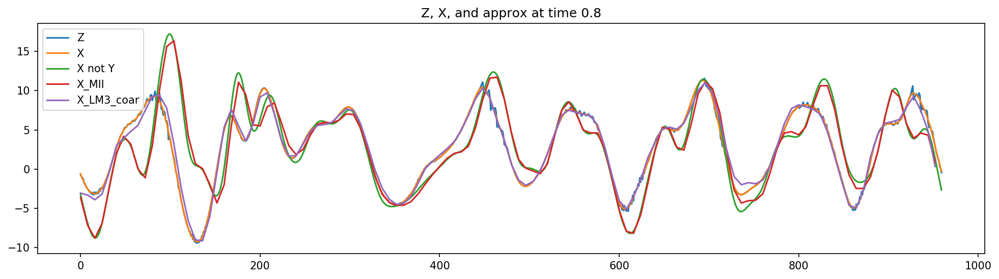

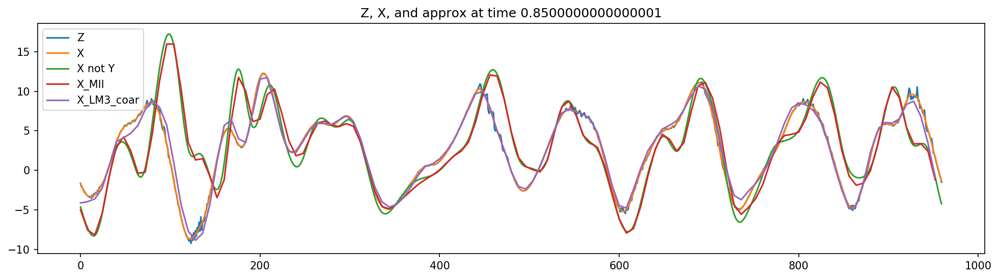

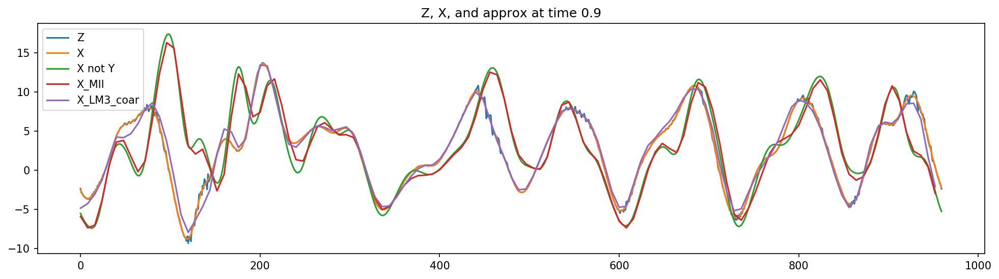

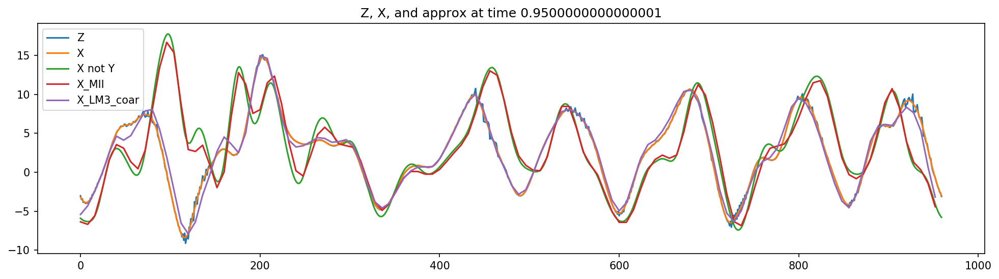

In [313]:
num_steps = 20
for ii in range(num_steps): #range(XY.shape[0]):
#     ii = 5 * ii
    Z_to_plot = Z_GT[:, ii]
    X_to_plot = X_GT[:, ii]
    X_coarse_to_plot = X_coarse_GT[:, ii]
    X_LM3_coar_to_plot = X_LM3_coar[:, ii]
    X_not_Y_to_plot = X_not_Y_GT[:, ii]
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_to_plot)
    plt.plot(X_to_plot)
    plt.plot(X_not_Y_to_plot)
        
    plt.plot(x[::8], X_coarse_to_plot)
    plt.plot(x[::8], X_LM3_coar_to_plot)
    
    plt.title(f'Z, X, and approx at time {t[ii]}')
    plt.legend(['Z', 'X', 'X not Y', 'X_MII', 'X_LM3_coar'])

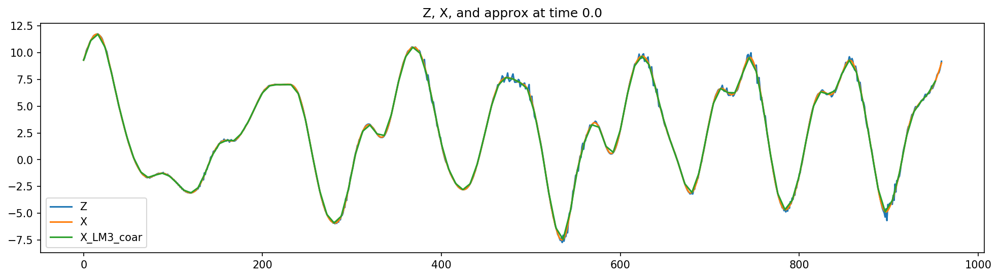

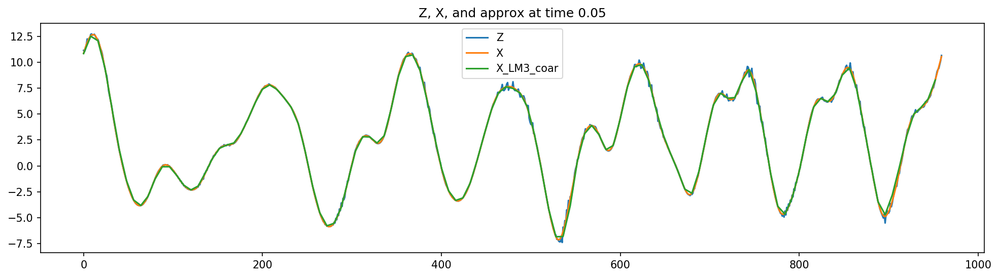

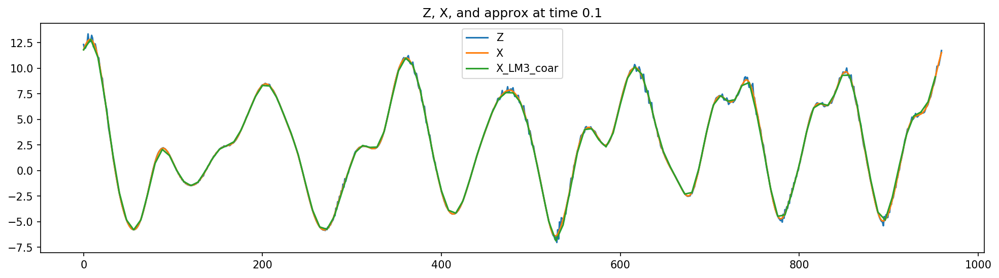

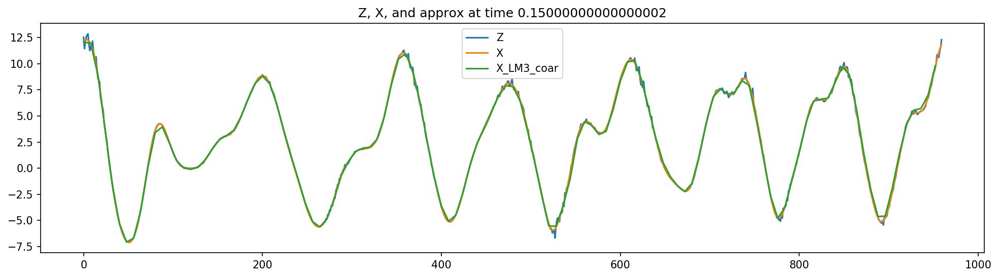

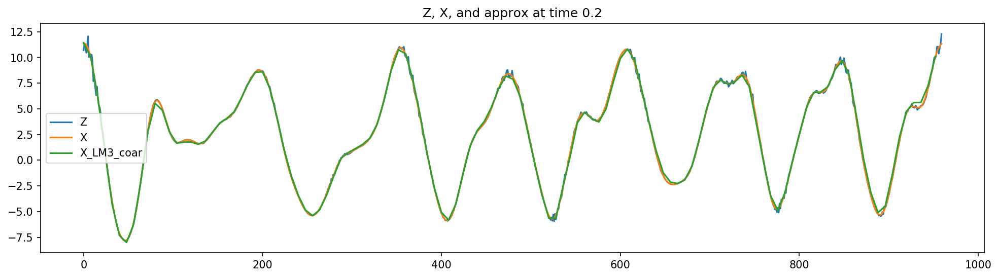

...

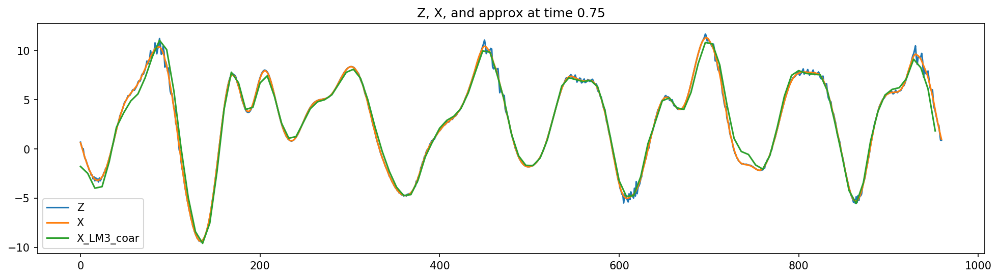

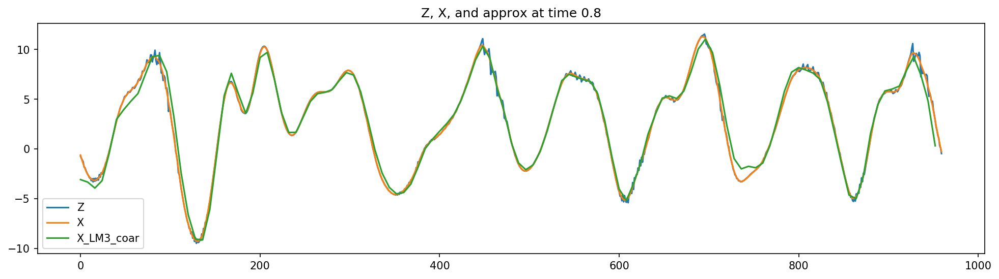

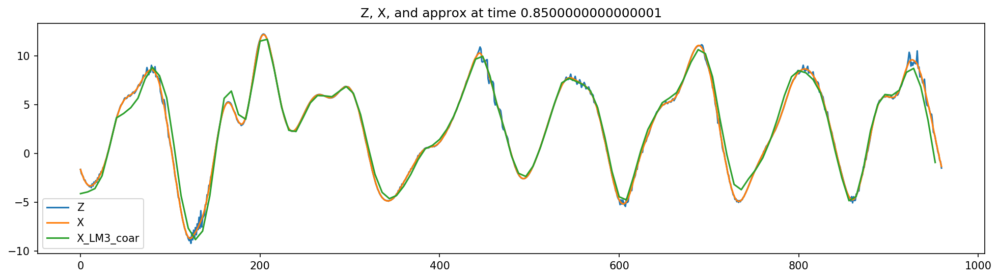

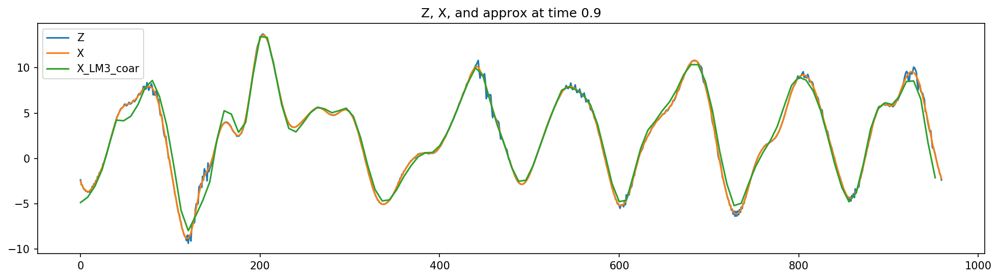

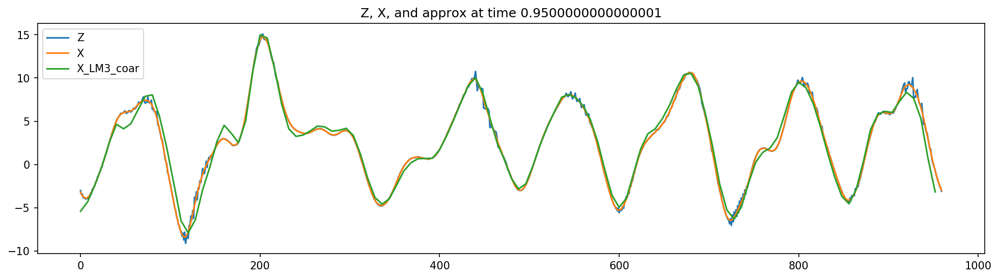

In [314]:
num_steps = 20
for ii in range(num_steps): #range(XY.shape[0]):
#     ii = 5 * ii
    Z_to_plot = Z_GT[:, ii]
    X_to_plot = X_GT[:, ii]
    X_LM3_coar_to_plot = X_LM3_coar[:, ii]
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_to_plot)
    plt.plot(X_to_plot)
    plt.plot(x[::8], X_LM3_coar_to_plot)
    
    plt.title(f'Z, X, and approx at time {t[ii]}')
    plt.legend(['Z', 'X', 'X_LM3_coar'])

In [315]:
def LM3_return_terms(Z, K=32, I=12, F=15, b=10, c=2.5, alpha=None, beta=None):
    if alpha is None:
        alpha = (3 * I**2 + 3) / (2 * I**3 + 4 * I)
    if beta is None:
        beta = (2 * I**2 + 1) / (I**4 + 2 * I**2)
    X = window_sum_Z(Z, I=I, alpha=alpha, beta=beta)
    Y = Z - X
    
    BXXK = bracket([X], K)
    BYY = b**2 * bracket([Y], 1)
    BYX = c * bracket([Y, X], 1)
    nX = -1 * X
    nY = -b * Y
    
    dZdt = BXXK + BYY + BYX + nX + nY + F
    return dZdt, BXXK, BYY, BYX, nX, nY, F

In [316]:
dZdt, BXXK, BYY, BYX, nX, nY, F = LM3_return_terms(Z_GT, K=K, I=I, F=F, b=b, c=c)

In [317]:
BXXK.shape

(960, 20001)

In [318]:
dZdt.shape

(960, 20001)

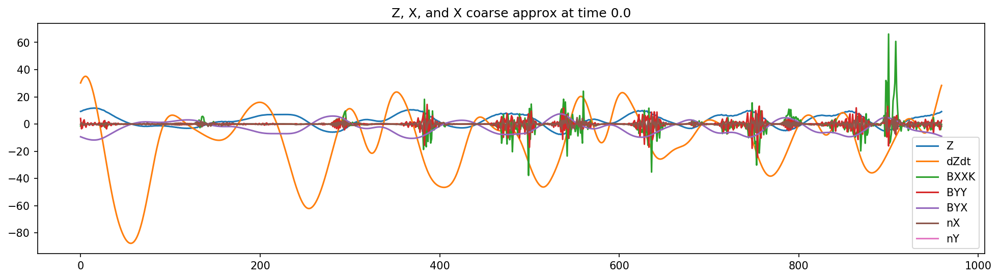

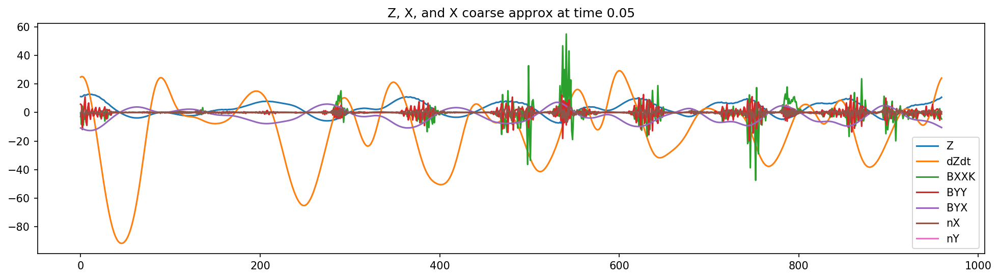

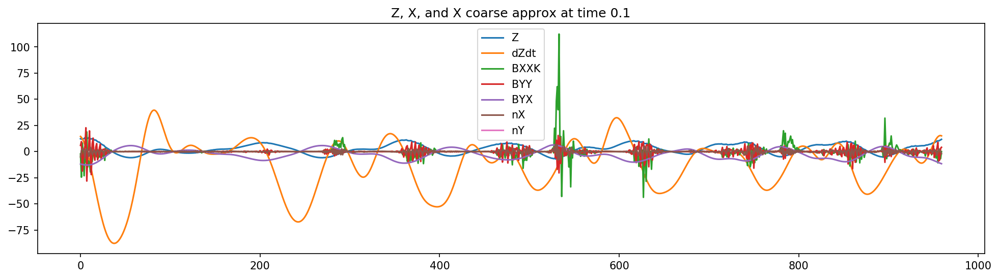

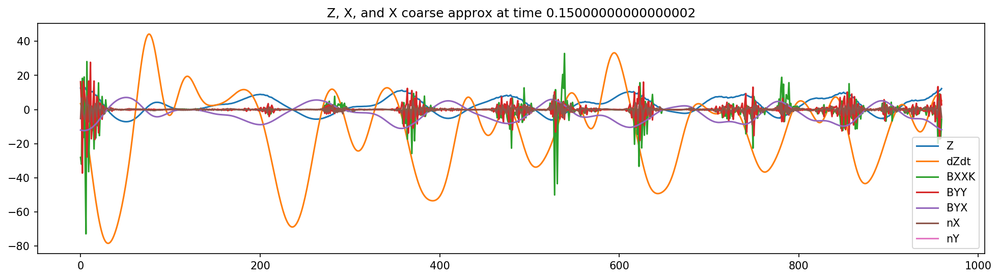

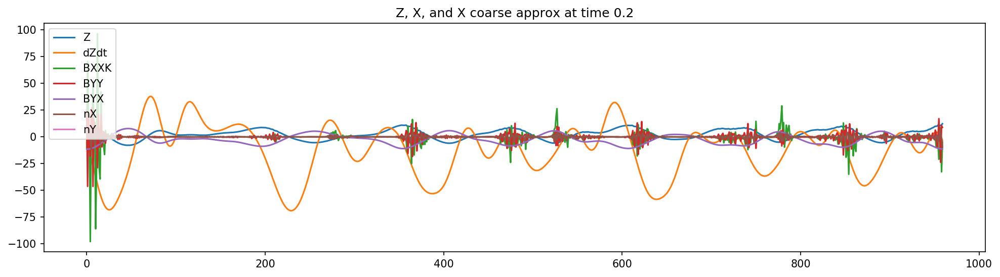

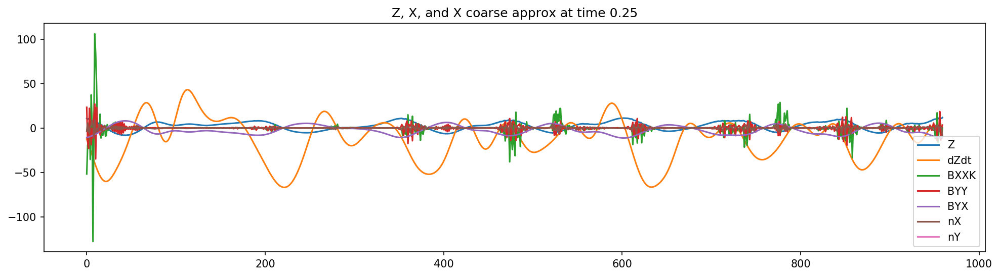

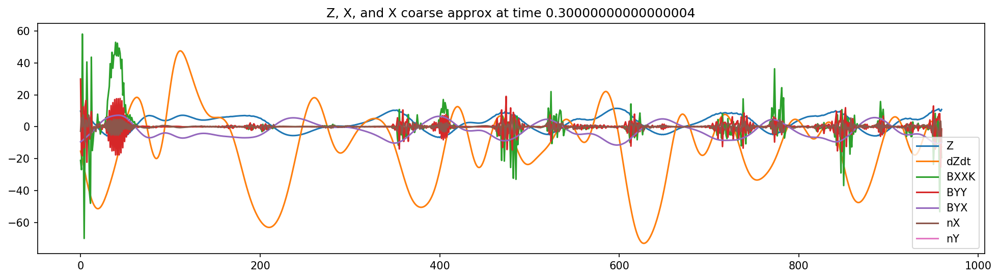

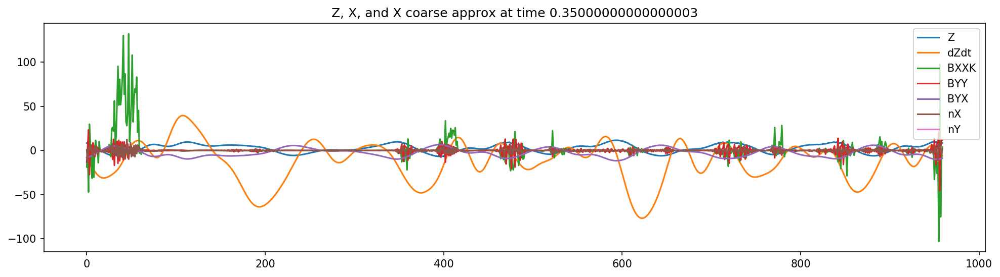

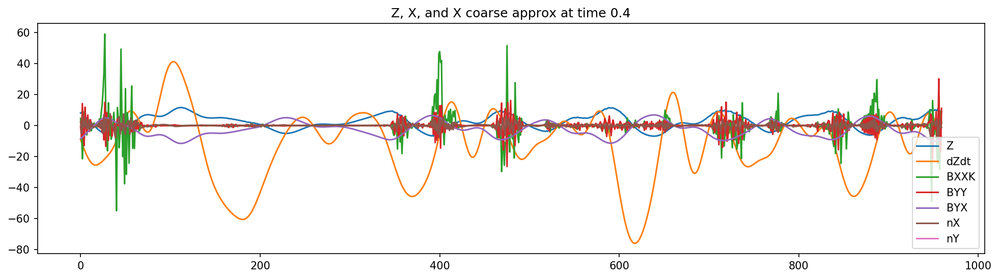

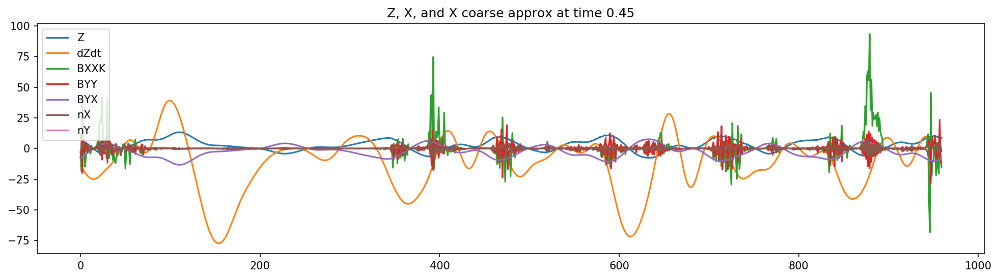

In [319]:
num_steps = 10
for ii in range(num_steps): #range(XY.shape[0]):
#     ii = 5 * ii
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_GT[:, ii])
    plt.plot(BXXK[:, ii])
    plt.plot(BYY[:, ii])
    plt.plot(BYX[:, ii])
    plt.plot(nX[:, ii])
    plt.plot(nY[:, ii])
    plt.plot(F)
    plt.title(f'Z, X, and X coarse approx at time {t[ii]}')
    plt.legend(['Z', 'dZdt', 'BXXK', 'BYY', 'BYX', 'nX', 'nY', F])

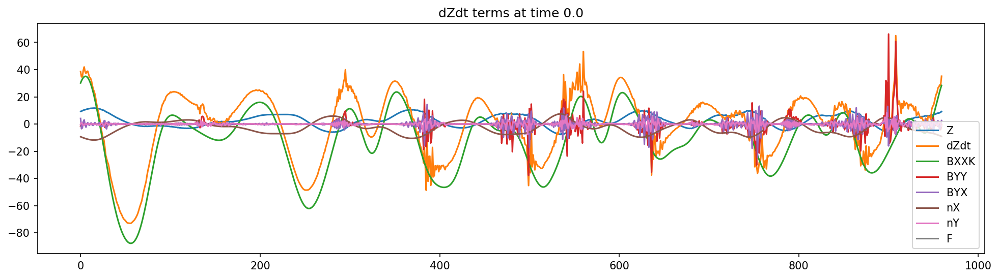

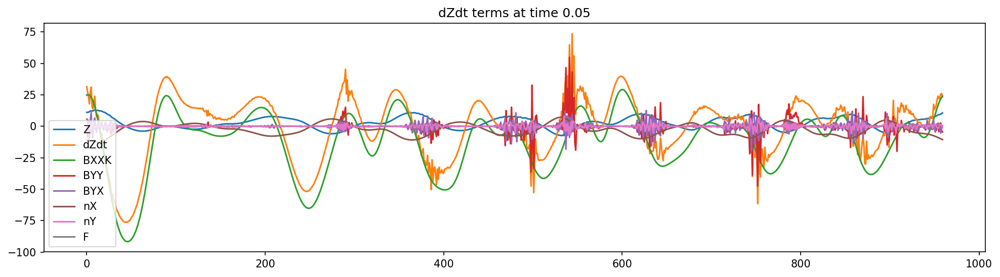

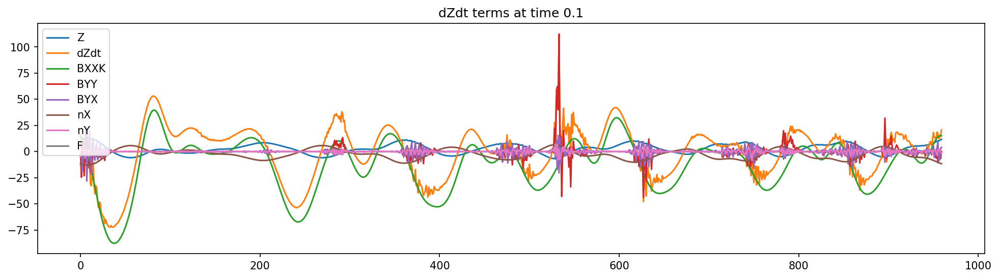

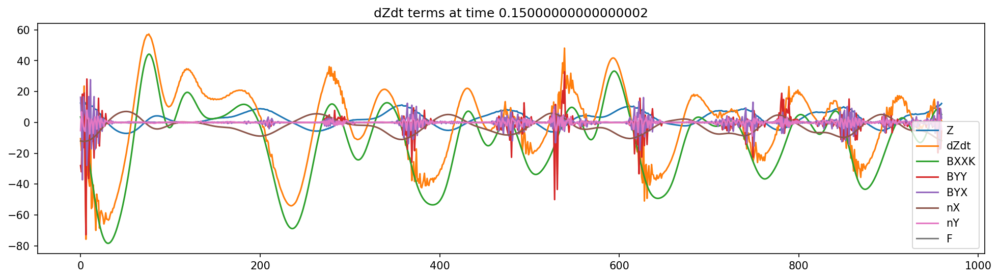

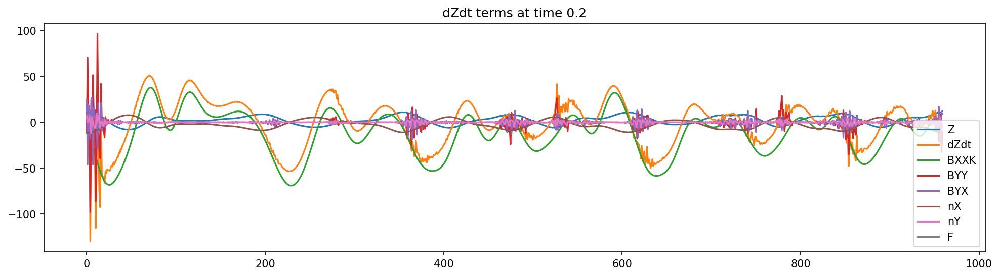

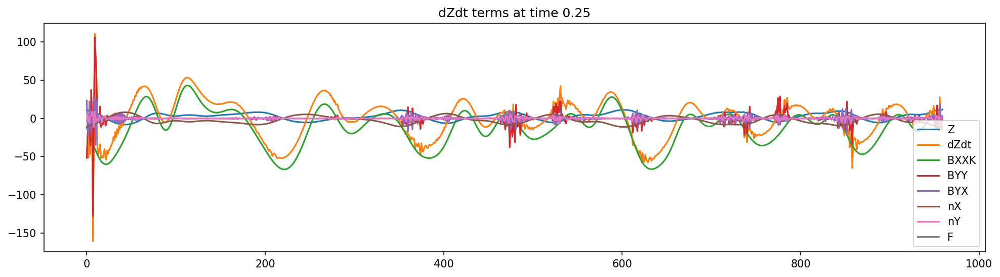

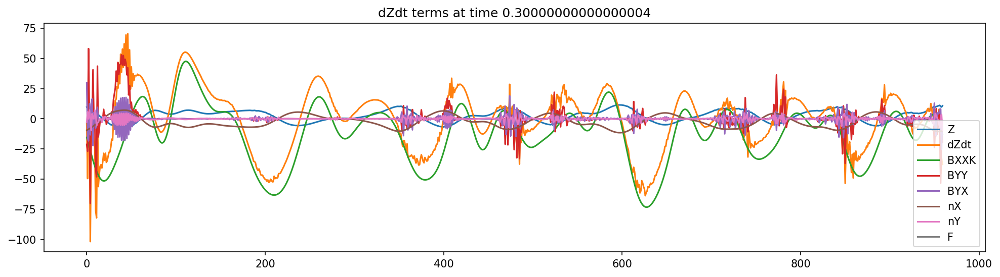

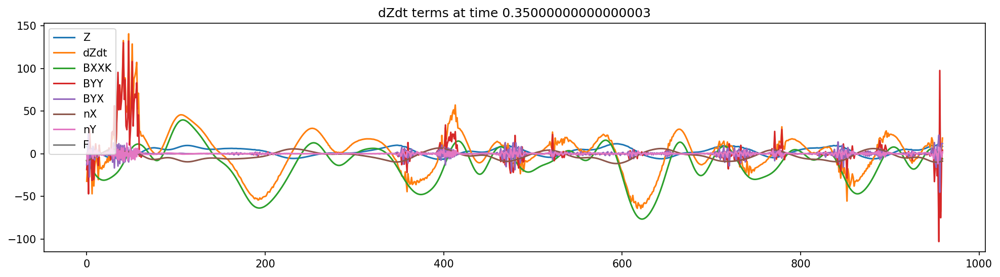

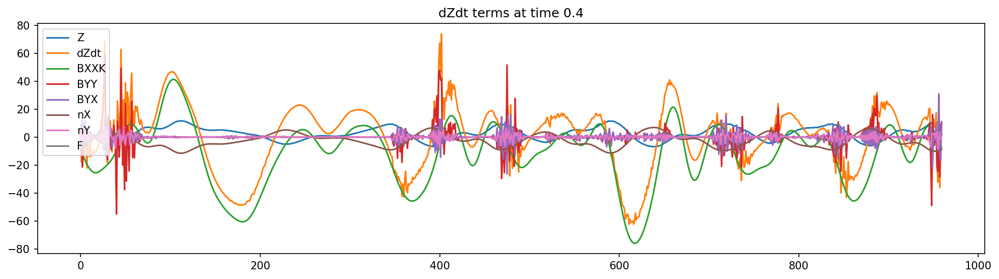

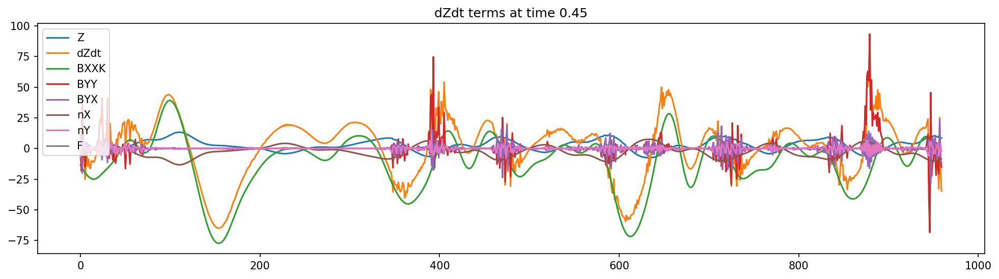

In [320]:
num_steps = 10
for ii in range(num_steps): #range(XY.shape[0]):
#     ii = 5 * ii
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_GT[:, ii])
    plt.plot(dZdt[:, ii])
    plt.plot(BXXK[:, ii])
    plt.plot(BYY[:, ii])
    plt.plot(BYX[:, ii])
    plt.plot(nX[:, ii])
    plt.plot(nY[:, ii])
    plt.plot(F)
    plt.title(f'dZdt terms at time {t[ii]}')
    plt.legend(['Z', 'dZdt', 'BXXK', 'BYY', 'BYX', 'nX', 'nY', 'F'])

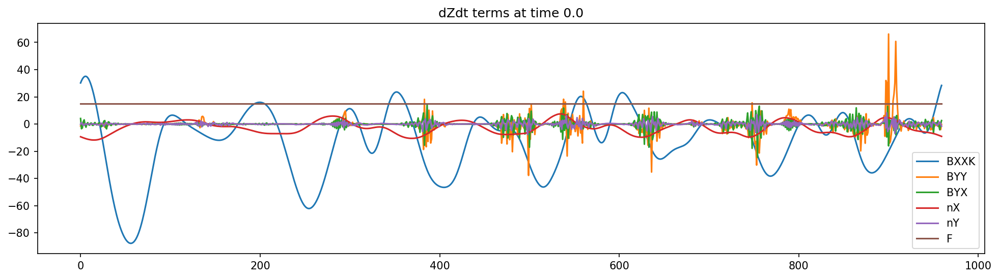

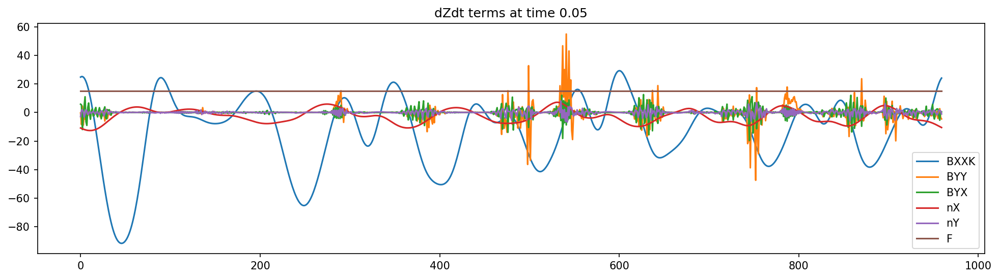

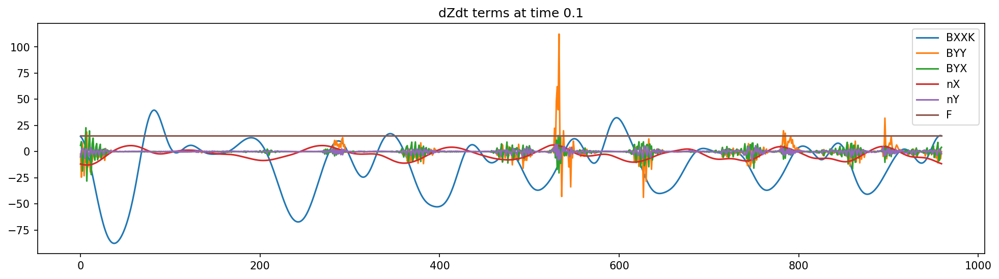

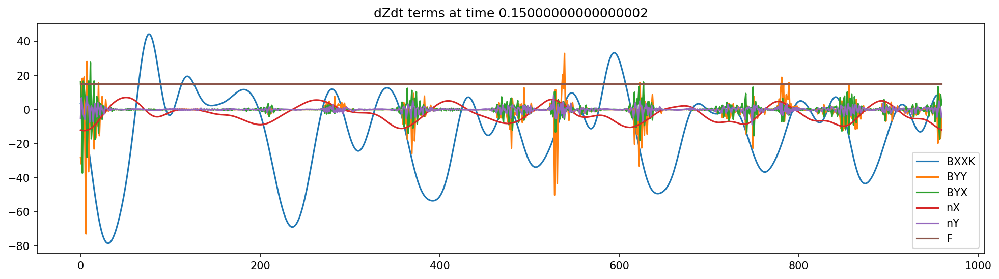

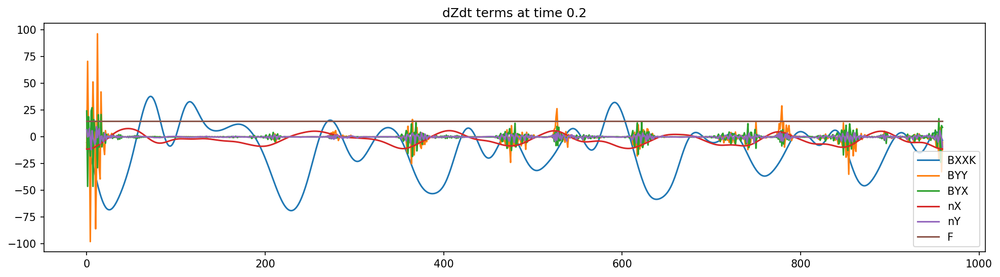

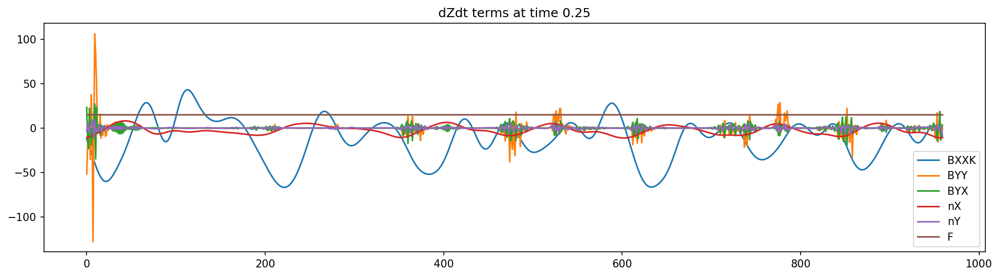

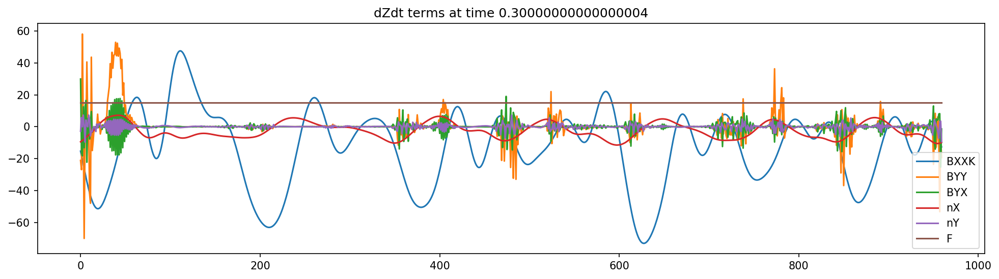

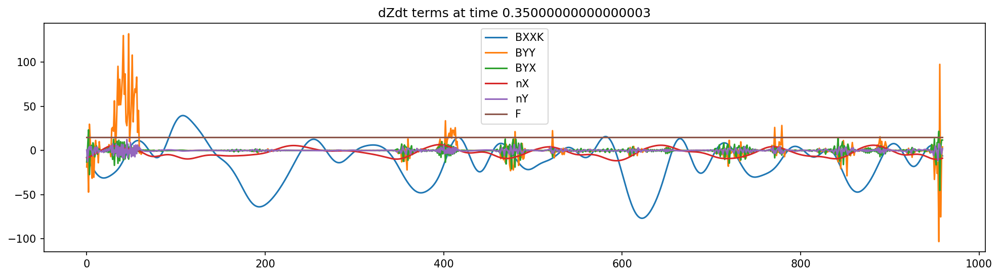

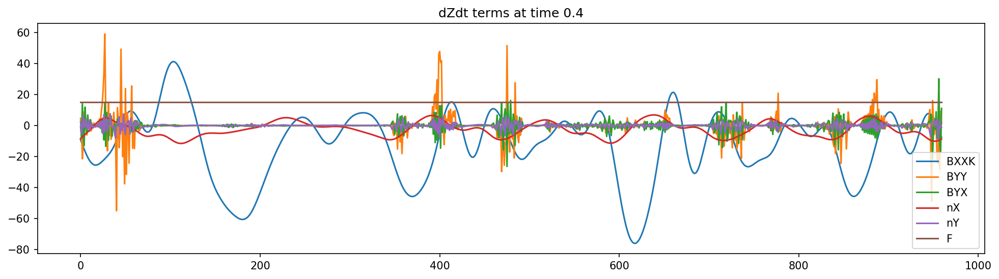

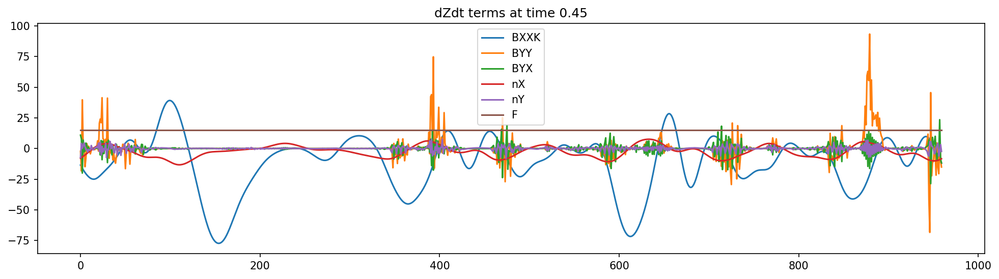

In [321]:
num_steps = 10
for ii in range(num_steps): #range(XY.shape[0]):
#     ii = 5 * ii
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(BXXK[:, ii])
    plt.plot(BYY[:, ii])
    plt.plot(BYX[:, ii])
    plt.plot(nX[:, ii])
    plt.plot(nY[:, ii])
    plt.plot(F * np.ones(N_Z))
    plt.title(f'dZdt terms at time {t[ii]}')
    plt.legend(['BXXK', 'BYY', 'BYX', 'nX', 'nY', 'F'])

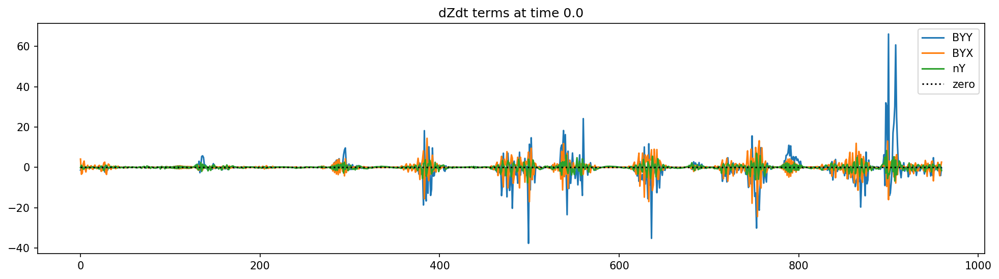

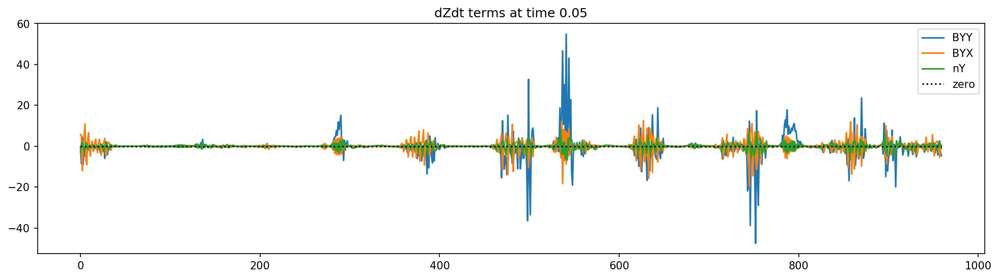

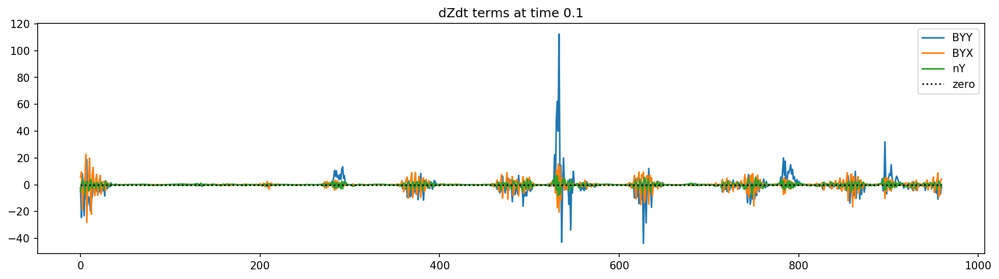

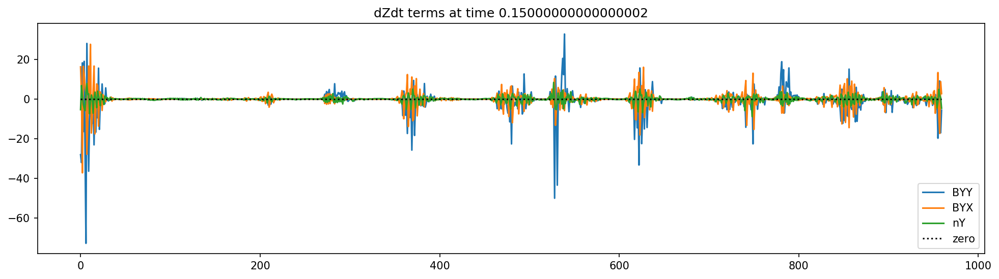

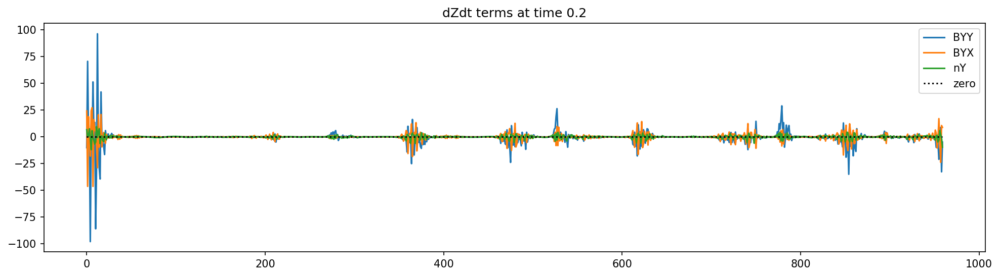

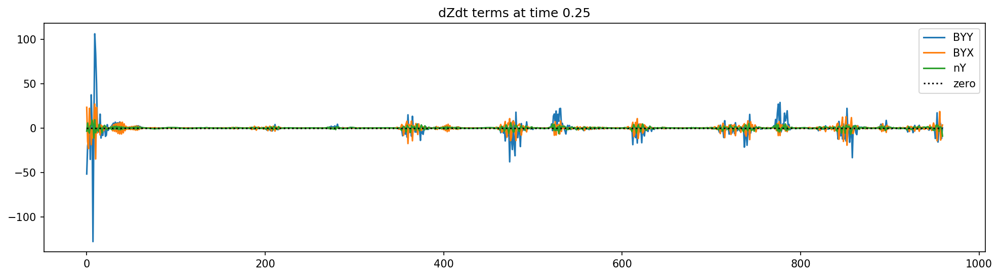

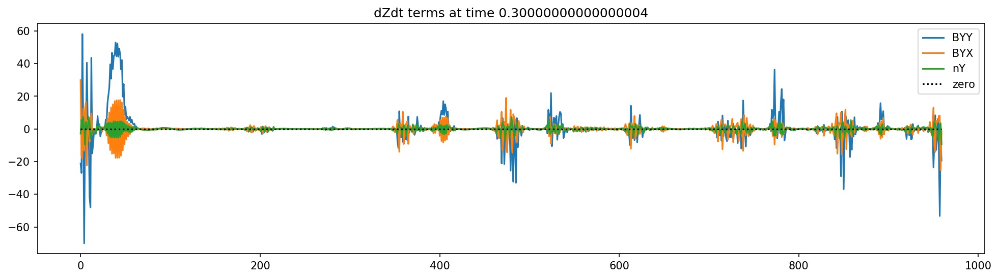

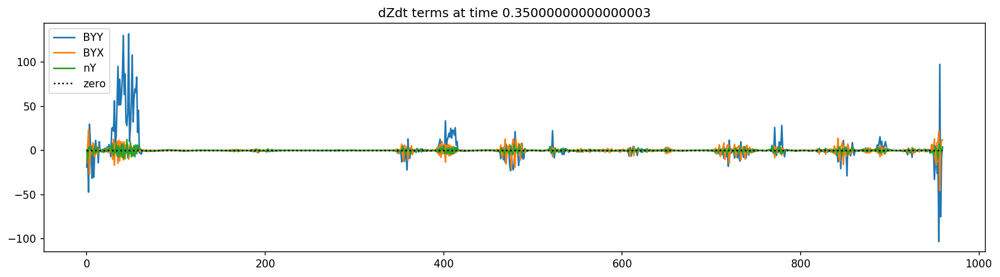

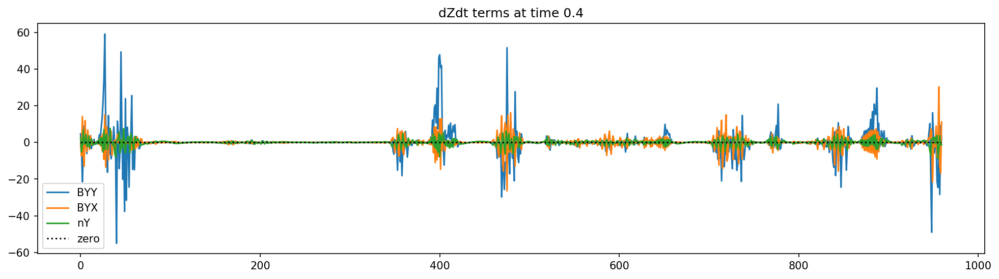

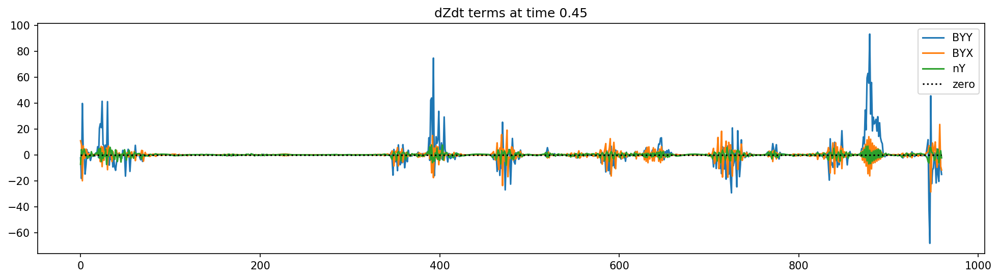

In [322]:
num_steps = 10
for ii in range(num_steps): #range(XY.shape[0]):
#     ii = 5 * ii
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(BYY[:, ii])
    plt.plot(BYX[:, ii])
    plt.plot(nY[:, ii])
    plt.plot(np.zeros(N_Z), 'k:')
    plt.title(f'dZdt terms at time {t[ii]}')
    plt.legend(['BYY', 'BYX', 'nY', 'zero'])

In [323]:
wBYY = window_sum_Z(BYY, I=I, alpha=alpha, beta=beta)
wBYX = window_sum_Z(BYX, I=I, alpha=alpha, beta=beta)
wnY = window_sum_Z(nY, I=I, alpha=alpha, beta=beta)

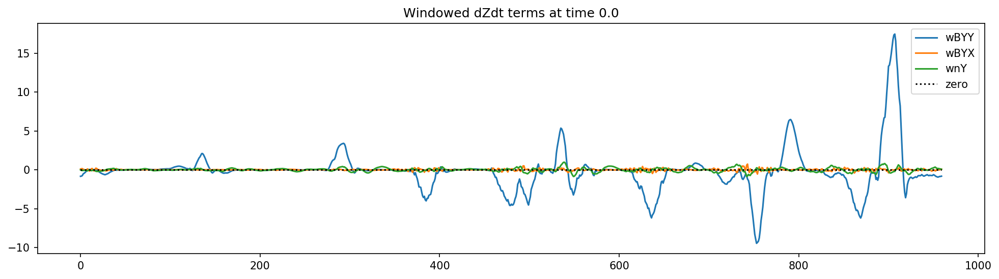

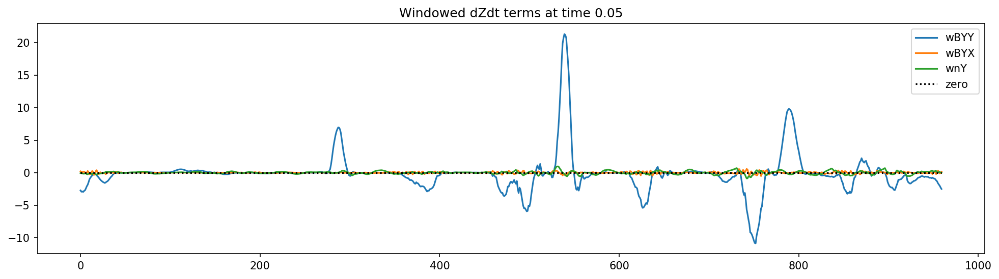

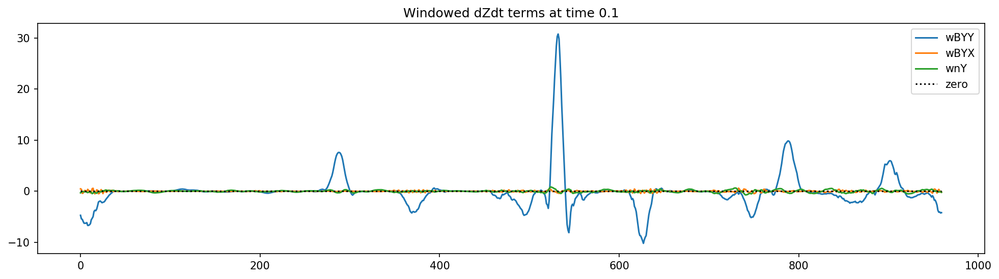

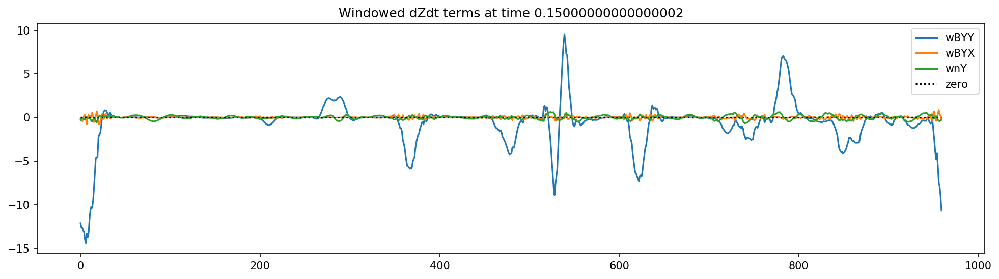

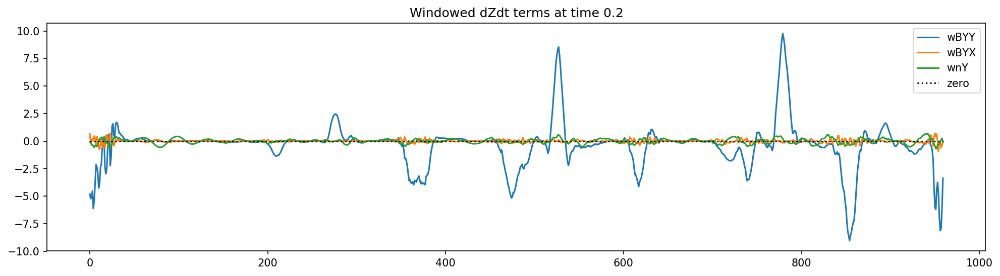

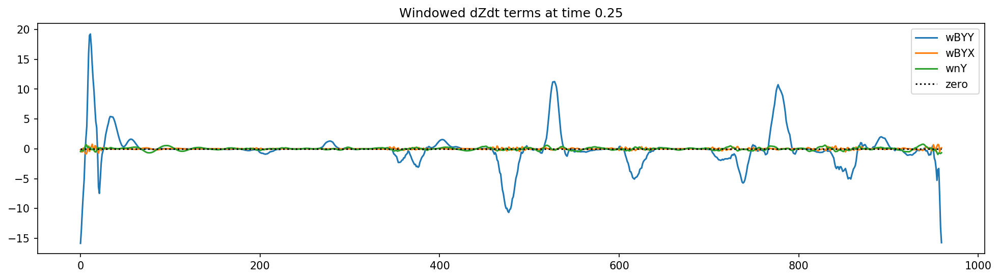

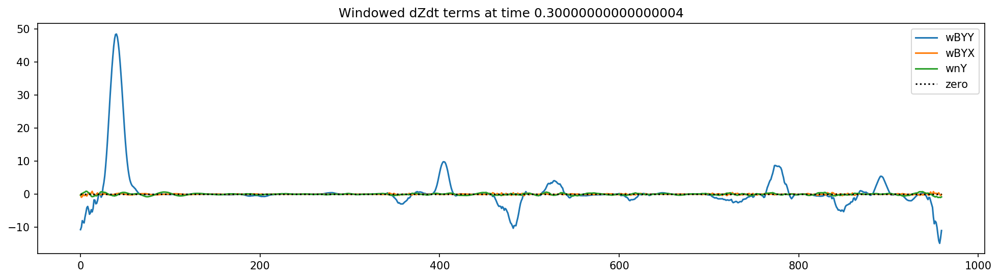

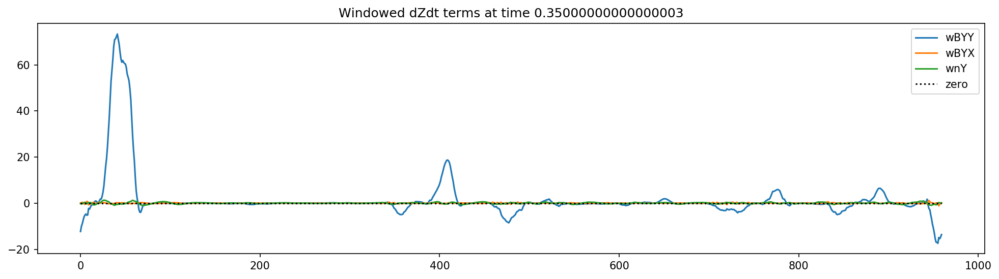

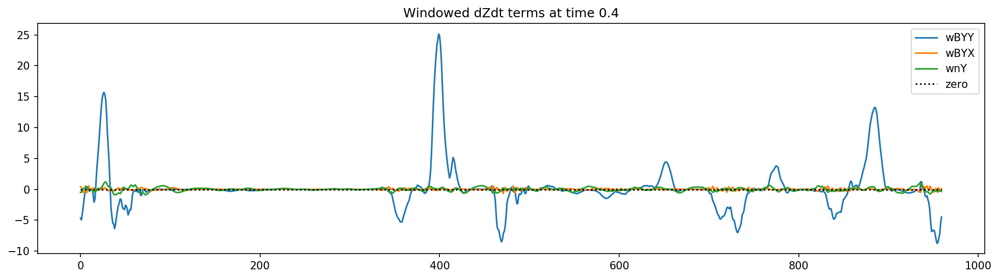

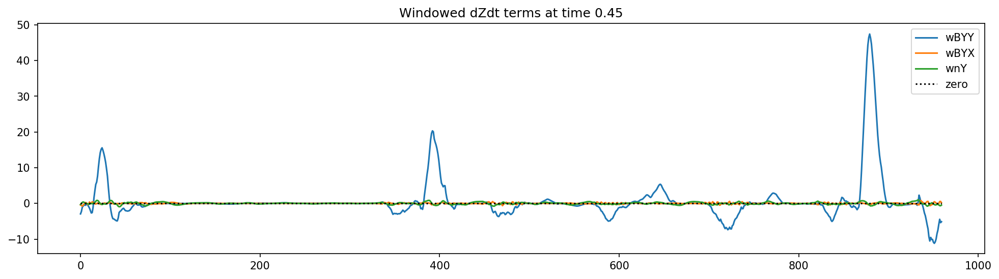

In [324]:
num_steps = 10
for ii in range(num_steps): #range(XY.shape[0]):
#     ii = 5 * ii
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(wBYY[:, ii])
    plt.plot(wBYX[:, ii])
    plt.plot(wnY[:, ii])
    plt.plot(np.zeros(N_Z), 'k:')
    plt.title(f'Windowed dZdt terms at time {t[ii]}')
    plt.legend(['wBYY', 'wBYX', 'wnY', 'zero'])

Text(0,0.5,'Windowed BYY')

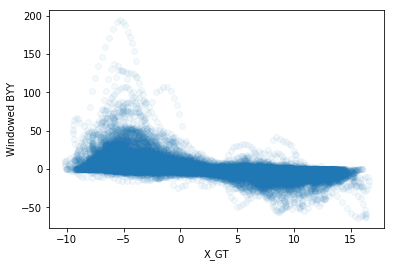

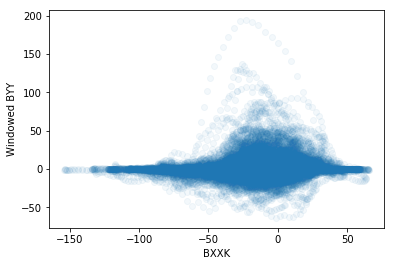

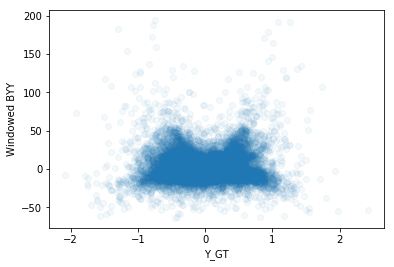

In [325]:
plt.figure()
plt.scatter(X_GT[:, ::100], wBYY[:, ::100], alpha=.05)
plt.xlabel('X_GT')
plt.ylabel('Windowed BYY')

plt.figure()
plt.scatter(BXXK[:, ::100], wBYY[:, ::100], alpha=.05)
plt.xlabel('BXXK')
plt.ylabel('Windowed BYY')

plt.figure()
plt.scatter(Y_GT[:, ::100], wBYY[:, ::100], alpha=.05)
plt.xlabel('Y_GT')
plt.ylabel('Windowed BYY')

Text(0,0.5,'BYY')

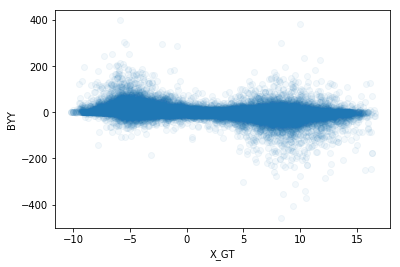

In [326]:
plt.figure()
plt.scatter(X_GT[:, ::100], BYY[:, ::100], alpha=.05)
plt.xlabel('X_GT')
plt.ylabel('BYY')